In [9]:
import os 
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import mean_absolute_error
import lightgbm as lgb

def case_preprocessing():
    dataset = list()
    only_train_dataset = list()
    df = pd.DataFrame()
    train_df = pd.DataFrame()   # 새로운 Col 만들기 
    dir_path = 'C:\\Users\\gusrl\\opendrift\\drift_trajection'
    pastDir_path = 'C:\\Users\\gusrl\\opendrift\\drift_trajection\\Past_data'
    
    # hour, wind(바람의 x축,y축 방향 각각 제곱합의 루트), water(해류의 x축,y축 방향 각각 제곱합의 루트)
    for k in range(1,16):
        only_train_dataset.append(pd.read_csv(os.path.join(pastDir_path ,(str(k)+'.csv'))))
                                  
    # 2016 (case 7) (동해)
    dataset.append(pd.read_csv(os.path.join(dir_path,'2016_case_003.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2016_case_005.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2016_case_010.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2016_case_011.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2016_case_015.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2016_case_016.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2016_case_040.csv')))

    # 2018(case 12) (서해)
    dataset.append(pd.read_csv(os.path.join(dir_path,'2018_case_005.csv')))
    # dataset_list.append(pd.read_csv(os.path.join(dir_path,'2018_case_008.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2018_case_017.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2018_case_027.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2018_case_032.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2018_case_034.csv')))
    # dataset_list.append(pd.read_csv(os.path.join(dir_path,'2018_case_045.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2018_case_047.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2018_case_082.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2018_case_083.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2018_case_090.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2018_case_095.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2018_case_097.csv')))

    # 2019(case 4) (남해)
    dataset.append(pd.read_csv(os.path.join(dir_path,'2019_case_000.csv')))
#     dataset.append(pd.read_csv(os.path.join(dir_path,'2019_case_001.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2019_case_006.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2019_case_007.csv')))
    dataset.append(pd.read_csv(os.path.join(dir_path,'2019_case_005.csv')))
    
    # 과거데이터 전처리 
    for i in range(len(only_train_dataset)):
        # 동해 서해 남해 
        if i <8:
            only_train_dataset[i]['E'] = 0
            only_train_dataset[i]['W'] = 0
            only_train_dataset[i]['S'] = 1
        else:
            only_train_dataset[i]['E'] = 0
            only_train_dataset[i]['W'] = 1
            only_train_dataset[i]['S'] = 0
        
        # 시간처리를 위해 time의 object type -> datetime64로 변경
        only_train_dataset[i]['time'] = pd.to_datetime(only_train_dataset[i]['time'],format = '%Y-%m-%d %H:%M', errors = 'raise')
        # hour열 생성
        only_train_dataset[i]['hour'] = only_train_dataset[i]['time'].dt.hour
        # wind 열 생성
        only_train_dataset[i]['wind'] = (only_train_dataset[i]['wind_x']**2 + only_train_dataset[i]['wind_y']**2)**(1/2)
        # water열 생성
        only_train_dataset[i]['water'] = (only_train_dataset[i]['water_velocity_x']**2 + only_train_dataset[i]['water_velocity_y']**2)**(1/2)
        # diff_lon열 생성
        only_train_dataset[i]['diff_lon'] = only_train_dataset[i]['obs_x1_lon'].diff() 
        only_train_dataset[i]['diff_lon'][0] = 0
        # diff_lat열 생성
        only_train_dataset[i]['diff_lat'] = only_train_dataset[i]['obs_x1_lat'].diff()
        only_train_dataset[i]['diff_lat'][0] = 0
        # 'diff_wind_x'열 생성
        only_train_dataset[i]['diff_wind_x'] = only_train_dataset[i]['wind_x'].diff() 
        only_train_dataset[i]['diff_wind_x'][0] = 0
        # 'diff_wind_y'열 생성
        only_train_dataset[i]['diff_wind_y'] = only_train_dataset[i]['wind_y'].diff()
        only_train_dataset[i]['diff_wind_y'][0] = 0
        # 'diff_wind_x'열 생성
        only_train_dataset[i]['diff_water_velocity_x'] = only_train_dataset[i]['water_velocity_x'].diff() 
        only_train_dataset[i]['diff_water_velocity_x'][0] = 0
        # 'diff_wind_y'열 생성
        only_train_dataset[i]['diff_water_velocity_y'] = only_train_dataset[i]['water_velocity_y'].diff() 
        only_train_dataset[i]['diff_water_velocity_y'][0] = 0
        # 초기 이동 고려 (원-핫 인코딩)
        only_train_dataset[i]['initial'] = 0
        only_train_dataset[i]['not_initial'] = 0
        for j in range(0,10):
            only_train_dataset[i]['not_initial'][j] = 0
            only_train_dataset[i]['initial'][j] = 1
        
        # model_x2_lon
        # diff_lon열 생성
        only_train_dataset[i]['diff_mod_lon'] = only_train_dataset[i]['model_x2_lon'].diff() 
        only_train_dataset[i]['diff_mod_lon'][0] = 0
        # diff_lat열 생성
        only_train_dataset[i]['diff_mod_lat'] = only_train_dataset[i]['model_x2_lat'].diff()
        only_train_dataset[i]['diff_mod_lat'][0] = 0
        
        only_train_dataset[i]['water_velocity_x_10'] = only_train_dataset[i]['water_velocity_x'] * 10
        only_train_dataset[i]['water_velocity_y_10'] = only_train_dataset[i]['water_velocity_y'] * 10
        
        # diff열 생성
        only_train_dataset[i]['diff'] = (only_train_dataset[i]['diff_lon']**2 + only_train_dataset[i]['diff_lat']**2)**(1/2)
        only_train_dataset[i]['diff'] = only_train_dataset[i]['diff']
        
        # Null 값 제외
        
        only_train_dataset[i] = only_train_dataset[i].dropna()
        only_train_dataset[i] = only_train_dataset[i].reset_index(drop = True)
        
        
        # 초기좌표 (해역 나누기)
        only_train_dataset[i]['start_lon'] = only_train_dataset[i]['obs_x1_lon'][0]
        only_train_dataset[i]['start_lat'] = only_train_dataset[i]['obs_x1_lat'][0]
        
        # Smoothing (wind_x_ma, wind_y_ma, water_velocity_x_ma, water_velocity_y_ma 인자 추가) 
        only_train_dataset[i]['wind_x_ma'] = 0
        only_train_dataset[i]['wind_y_ma'] = 0
        only_train_dataset[i]['water_velocity_x_ma'] = 0
        only_train_dataset[i]['water_velocity_y_ma'] = 0 
        for j in range(1,len(only_train_dataset[i])-1):
            only_train_dataset[i]['wind_x_ma'][j] = (only_train_dataset[i]['wind_x'][j-1] + only_train_dataset[i]['wind_x'][j] + only_train_dataset[i]['wind_x'][j+1])/3
            only_train_dataset[i]['wind_y_ma'][j] = (only_train_dataset[i]['wind_y'][j-1] + only_train_dataset[i]['wind_y'][j] + only_train_dataset[i]['wind_y'][j+1])/3
            only_train_dataset[i]['water_velocity_x_ma'][j] = (only_train_dataset[i]['water_velocity_x'][j-1] + only_train_dataset[i]['water_velocity_x'][j] + only_train_dataset[i]['water_velocity_x'][j+1])/3
            only_train_dataset[i]['water_velocity_y_ma'][j] = (only_train_dataset[i]['water_velocity_y'][j-1] + only_train_dataset[i]['water_velocity_y'][j] + only_train_dataset[i]['water_velocity_y'][j+1])/3    
        df = only_train_dataset[i]
        indices = df.query('wind_x < -90 or wind_y < -90 or water_velocity_x < -90 or water_velocity_y < -90').index
        df.drop(indices, inplace=True)
        df.reset_index(drop = True, inplace=True)
        only_train_dataset[i] = df 
        
     # 기상청 데이터 전처리 
    for i in range(len(dataset)):
        # 동해 서해 남해 
        if i <7:
            dataset[i]['E'] = 1
            dataset[i]['W'] = 0
            dataset[i]['S'] = 0
        elif i >= 7 and i<18:
            dataset[i]['E'] = 0
            dataset[i]['W'] = 1
            dataset[i]['S'] = 0
        else:
            dataset[i]['E'] = 0
            dataset[i]['W'] = 0
            dataset[i]['S'] = 1
        
        # 시간처리를 위해 time의 object type -> datetime64로 변경
        dataset[i]['time'] = pd.to_datetime(dataset[i]['time'],format = '%Y-%m-%d %H:%M', errors = 'raise')
        # hour열 생성
        dataset[i]['hour'] = dataset[i]['time'].dt.hour
        # wind 열 생성
        dataset[i]['wind'] = (dataset[i]['wind_x']**2 + dataset[i]['wind_y']**2)**(1/2)
        # water열 생성
        dataset[i]['water'] = (dataset[i]['water_velocity_x']**2 + dataset[i]['water_velocity_y']**2)**(1/2)
        # diff_lon열 생성
        dataset[i]['diff_lon'] = dataset[i]['obs_x1_lon'].diff() 
        dataset[i]['diff_lon'][0] = 0
        # diff_lat열 생성
        dataset[i]['diff_lat'] = dataset[i]['obs_x1_lat'].diff()
        dataset[i]['diff_lat'][0] = 0
        # 'diff_wind_x'열 생성
        dataset[i]['diff_wind_x'] = dataset[i]['wind_x'].diff() 
        dataset[i]['diff_wind_x'][0] = 0
        # 'diff_wind_y'열 생성
        dataset[i]['diff_wind_y'] = dataset[i]['wind_y'].diff()
        dataset[i]['diff_wind_y'][0] = 0
        # 'diff_wind_x'열 생성
        dataset[i]['diff_water_velocity_x'] = dataset[i]['water_velocity_x'].diff() 
        dataset[i]['diff_water_velocity_x'][0] = 0
        # 'diff_wind_y'열 생성
        dataset[i]['diff_water_velocity_y'] = dataset[i]['water_velocity_y'].diff() 
        dataset[i]['diff_water_velocity_y'][0] = 0
        
        # 초기 이동 고려 (원-핫 인코딩)
        dataset[i]['initial'] = 0
        dataset[i]['not_initial'] = 1
        for j in range(0,30):
            dataset[i]['not_initial'][j] = 0
            dataset[i]['initial'][j] = 1
        
        dataset[i]['diff_mod_lon'] = dataset[i]['model_x2_lon'].diff() 
        dataset[i]['diff_mod_lon'][0] = 0
        
        # diff_lat열 생성
        dataset[i]['diff_mod_lat'] = dataset[i]['model_x2_lat'].diff()
        dataset[i]['diff_mod_lat'][0] = 0
        
        # mod diff 
        dataset[i]['diff_mod'] = (dataset[i]['diff_mod_lon']**2 + dataset[i]['diff_mod_lat']**2)**(1/2)
        
        # diff열 생성
        dataset[i]['diff'] = (dataset[i]['diff_lon']**2 + dataset[i]['diff_lat']**2)**(1/2)
        
        # Null 값 제외
        dataset[i] = dataset[i].dropna()
        dataset[i] = dataset[i].reset_index(drop = True)
        
        # 초기좌표 (해역 나누기)
        dataset[i]['start_lon'] = dataset[i]['obs_x1_lon'][0]
        dataset[i]['start_lat'] = dataset[i]['obs_x1_lat'][0]
        
        # Smoothing (wind_x_ma, wind_y_ma, water_velocity_x_ma, water_velocity_y_ma 인자 추가) 
        dataset[i]['wind_x_ma'] = 0
        dataset[i]['wind_y_ma'] = 0
        dataset[i]['water_velocity_x_ma'] = 0
        dataset[i]['water_velocity_y_ma'] = 0 
        for j in range(1,len(dataset[i])-1):
            dataset[i]['wind_x_ma'][j] = (dataset[i]['wind_x'][j-1] + dataset[i]['wind_x'][j] + dataset[i]['wind_x'][j+1])/3
            dataset[i]['wind_y_ma'][j] = (dataset[i]['wind_y'][j-1] + dataset[i]['wind_y'][j] + dataset[i]['wind_y'][j+1])/3
            dataset[i]['water_velocity_x_ma'][j] = (dataset[i]['water_velocity_x'][j-1] + dataset[i]['water_velocity_x'][j] + dataset[i]['water_velocity_x'][j+1])/3
            dataset[i]['water_velocity_y_ma'][j] = (dataset[i]['water_velocity_y'][j-1] + dataset[i]['water_velocity_y'][j] + dataset[i]['water_velocity_y'][j+1])/3
        
        # 삭제 전 원본 df
        df = pd.concat([df,dataset[i]],ignore_index = True)
        # 불필요열 삭제 
        pre_df = dataset[i].drop(columns = ['time','obs_x1_lon','obs_x1_lat','model_x2_lon','model_x2_lat'])  
        train_df = pd.concat([train_df, pre_df[1:-1]],ignore_index = True)
        
    df = df.reset_index(drop = True)
    train_df = train_df.reset_index(drop = True)
    return dataset, df, train_df, only_train_dataset

def drift_mae(y, predict_y):
    mae = mean_absolute_error(y, predict_y)
    return mae


def n2_mae(y, predict_y):
    n = y.shape[0]
    error_sum = 0
    
    for i in range(n):
        error_sum += abs((y[i][0] - predict_y[i][0])) + abs(( y[i][1] - predict_y[i][1]))
    
    mae = error_sum/(2*n)   
    
    return mae


def paper_mae(y, predict_y): # 논문  
    n = y.shape[0]
    error_sum = 0
    
    for i in range(n):
        error_sum += abs(y[i][0] - predict_y[i][0]) + abs(y[i][1] - predict_y[i][1])
    
    mae = error_sum/n    
    return mae

def NCLS_score(y, predict_y): # 1시간 
        # dl_i 구하기 
        dl_list, dl_sum, o_sum = list(), list(), 0
        n = y.shape[0]
        for i in range(1, n):
            # 위도 1도는 111.321, 경도 1도는 87.74km, 단위 km
            d_lon = y[i][0] - y[i-1][0]  
            d_lat = y[i][1] - y[i-1][1]
            # 거리 구하기
            point_distance = np.sqrt(np.power(d_lon,2) + np.power(d_lat,2))
            dl_list.append(point_distance)
            
        for i in range(len(dl_list)):
            temp = 0
            for j in range(i+1):
                temp += dl_list[j]
            dl_sum.append(temp)

        for i in range(len(dl_sum)):
            o_sum += dl_sum[i]
        
        # 예측모델의 d_i 구하기
        d_list = list()
        for i in range(1,n):
            # 위도 1도는 111.321 # 경도 1도는 55.802km
            d_lon = y[i][0] - predict_y[i][0]  
            d_lat = y[i][1] - predict_y[i][1]
            # 거리 구하기
            point_distance = np.sqrt(np.power(d_lon,2) + np.power(d_lat,2))
            d_list.append(point_distance)

        # s 구하기
        d_sum, s, ss_score = 0, 0, 0

        for i in range(len(d_list)):
            d_sum += d_list[i]

        s = d_sum/o_sum
        
        if s > 1:
                ss_score = 0
        else:
            ss_score = 1-s
        
        return ss_score

def drift_trajection_show(index, y_pred): 
    %matplotlib inline

    # 실제 위치
    lon = dataset[index]['obs_x1_lon']
    lon = np.array(lon)
    lat = dataset[index]['obs_x1_lat']
    lat = np.array(lat)
    
    # baseline
    baseline_lon = dataset[index]['model_x2_lon']
    baseline_lon = np.array(baseline_lon)
    baseline_lat = dataset[index]['model_x2_lat']
    baseline_lat = np.array(baseline_lat)

    # 예측값 
    first_lon = lon[0]
    first_lat = lat[0]
    lon_pred = np.zeros((y_pred.shape[0]+1,))
    lat_pred = np.zeros((y_pred.shape[0]+1,))
    lon_pred[0] = first_lon 
    lat_pred[0] = first_lat
    
    for i in range(1, lon_pred.shape[0]):
        lon_pred[i] = lon_pred[i-1] + y_pred[i-1][0]
        lat_pred[i] = lat_pred[i-1] + y_pred[i-1][1]
        
    return lon, lat, baseline_lon, baseline_lat, lon_pred, lat_pred

def std_scaler(train_X, test_X):
    from sklearn.preprocessing import StandardScaler
    std = StandardScaler()
    std.fit(train_X)
    train_X_scaled = std.transform(train_X)
    test_X_scaled = std.transform(test_X)
    return train_X_scaled, test_X_scaled

def MinMax_scaler(train_X, test_X):
    from sklearn.preprocessing import MinMaxScaler
    mms = MinMaxScaler()
    mms.fit(train_X)
    train_X_scaled = mms.transform(train_X)
    test_X_scaled = mms.transform(test_X)
    return train_X_scaled, test_X_scaled
    
def roburst_scaler(train_X, test_X):
    from sklearn.preprocessing import RobustScaler
    rbs = RobustScaler()
    train_X_scaled = rbs.fit_transform(train_X)
    test_X_scaled = rbs.transform(test_X)
    return train_X_scaled, test_X_scaled


def maxAbsScaler(train_X, test_X):

    from sklearn.preprocessing import MaxAbsScaler
    maxAbsScaler = MaxAbsScaler()
    train_X_scaled = maxAbsScaler.fit_transform(train_X)
    test_X_scaled = maxAbsScaler.transform(test_X)
    return train_X_scaled, test_X_scaled

In [10]:
dataset, concat_df, train_df, only_train_dataset = case_preprocessing()

C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  only_train_dataset[i]['diff_lon'][0] = 0
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  only_train_dataset[i]['diff_lat'][0] = 0
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:80: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  only_train_data

C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:131: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  only_train_dataset[i]['water_velocity_y_ma'][j] = (only_train_dataset[i]['water_velocity_y'][j-1] + only_train_dataset[i]['water_velocity_y'][j] + only_train_dataset[i]['water_velocity_y'][j+1])/3
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  only_train_dataset[i]['diff_lon'][0] = 0
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame


C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  only_train_dataset[i]['diff_lon'][0] = 0
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  only_train_dataset[i]['diff_lat'][0] = 0
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:80: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  only_train_data

C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:215: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset[i]['wind_x_ma'][j] = (dataset[i]['wind_x'][j-1] + dataset[i]['wind_x'][j] + dataset[i]['wind_x'][j+1])/3
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:216: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset[i]['wind_y_ma'][j] = (dataset[i]['wind_y'][j-1] + dataset[i]['wind_y'][j] + dataset[i]['wind_y'][j+1])/3
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:217: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the c

C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:218: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset[i]['water_velocity_y_ma'][j] = (dataset[i]['water_velocity_y'][j-1] + dataset[i]['water_velocity_y'][j] + dataset[i]['water_velocity_y'][j+1])/3
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:164: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset[i]['diff_lon'][0] = 0
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:167: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas

C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:164: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset[i]['diff_lon'][0] = 0
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:167: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset[i]['diff_lat'][0] = 0
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3953088137.py:170: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset[i]['diff_wind_x'][0] = 0
C

In [11]:
from tensorflow.keras.models import Model
from sklearn.metrics import mean_absolute_error
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.activations import relu
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import mean_absolute_error

class Autoencoder(Model):
    def __init__(self, latent_dim):
        super(Autoencoder, self).__init__()
        self.latent_dim = latent_dim   
        self.encoder = tf.keras.Sequential([
          Dense(units = latent_dim, input_dim = 6, activation='relu'),
        ])
        self.decoder = tf.keras.Sequential([
          Dense(6)
        ])

    def call(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

Epoch 1/150
93/93 [==============================] - 1s 1ms/step - loss: 8.7589
Epoch 2/150
93/93 [==============================] - 0s 935us/step - loss: 8.1823
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.8276
Epoch 4/150
93/93 [==============================] - 0s 944us/step - loss: 7.5866
Epoch 5/150
93/93 [==============================] - 0s 963us/step - loss: 7.4074
Epoch 6/150
93/93 [==============================] - 0s 977us/step - loss: 7.2891
Epoch 7/150
93/93 [==============================] - 0s 980us/step - loss: 7.2085
Epoch 8/150
93/93 [==============================] - 0s 969us/step - loss: 7.1534
Epoch 9/150
93/93 [==============================] - 0s 984us/step - loss: 7.1167
Epoch 10/150
93/93 [==============================] - 0s 973us/step - loss: 7.0924
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0758
Epoch 12/150
93/93 [==============================] - 0s 958us/step - loss: 7.0641
Epoch 13/150
93/93 

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
Epoch 1/150
93/93 [==============================] - 1s 1ms/step - loss: 8.4932
Epoch 2/150
93/93 [==============================] - 0s 981us/step - loss: 7.9445
Epoch 3/150
93/93 [==============================] - 0s 951us/step - loss: 7.6299
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.4847
Epoch 5/150
93/93 [==============================] - 0s 988us/step - loss: 7.3967
Epoch 6/150
93/93 [==============================] - 0s 993us/step - loss: 7.3414
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3064
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2820
Epoch 9/150
93/93 [==============================] - 0s 987us/step - loss: 7.2632
Epoch 10/150
93/93 [==============================] - 0s 1ms/st

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
Epoch 1/150
93/93 [==============================] - 1s 1ms/step - loss: 8.9200
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 8.5895
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 8.3528
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 8.1356
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.8817
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.6355
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.4370
Epoch 8/150
93/93 [=====================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
Epoch 1/150
93/93 [==============================] - 1s 1ms/step - loss: 8.4402
Epoch 2/150
93/93 [==============================] - 0s 997us/step - loss: 8.0465
Epoch 3/150
93/93 [==============================] - 0s 953us/step - loss: 7.7402
Epoch 4/150
93/93 [==============================] - 0s 954us/step - loss: 7.5609
Epoch 5/150
93/93 [==============================] - 0s 987us/step 

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
Epoch 1/150
93/93 [==============================] - 1s 1ms/step - loss: 8.5580
Epoch 2/150
93/93 [==============================] - 0s 931us/step - loss: 8.0813
Epoch 3/150
93/93 [====================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

93/93 [==============================] - 0s 1ms/step - loss: 7.1218
Epoch 75/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1218
Epoch 76/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1217
Epoch 77/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1216
Epoch 78/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1216
Epoch 79/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1215
Epoch 80/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1214
Epoch 81/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1213
Epoch 82/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1212
Epoch 83/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1211
Epoch 84/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1210
Epoch 85/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1209
Epoch 86/150
93/93 [=====================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



93/93 [==============================] - 1s 1ms/step - loss: 8.6815
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 8.3040
Epoch 3/150
93/93 [==============================] - 0s 986us/step - loss: 8.0433
Epoch 4/150
93/93 [==============================] - 0s 986us/step - loss: 7.8577
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.6684
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.4677
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2851
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1616
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0927
Epoch 10/150
93/93 [==============================] - 0s 2ms/step - loss: 7.0542
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0307
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0152
Epoch 13/150
93/93 [=========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

93/93 [==============================] - 1s 1ms/step - loss: 8.8043
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 8.4950
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 8.1186
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.5881
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3880
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3176
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2727
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2396
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2150
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1968
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1834
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1730
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

Epoch 61/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0691
Epoch 62/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0689
Epoch 63/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0687
Epoch 64/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0686
Epoch 65/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0684
Epoch 66/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0683
Epoch 67/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0681
Epoch 68/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0679
Epoch 69/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0678
Epoch 70/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0676
Epoch 71/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0674
Epoch 72/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0673
Epoch 73/150
93/93 [========

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

90/90 [==============================] - 0s 1ms/step - loss: 6.8487


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

93/93 [==============================] - 0s 1ms/step - loss: 7.0317
Epoch 148/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0317
Epoch 149/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0316
Epoch 150/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0316


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1539422308.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2659307271347436
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2703819428096206
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37679888859737953
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.017170560134795676
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2838823486196478
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4286845786601964
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10444734169513872
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5197356531720435
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.21212881261475192
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5286789419

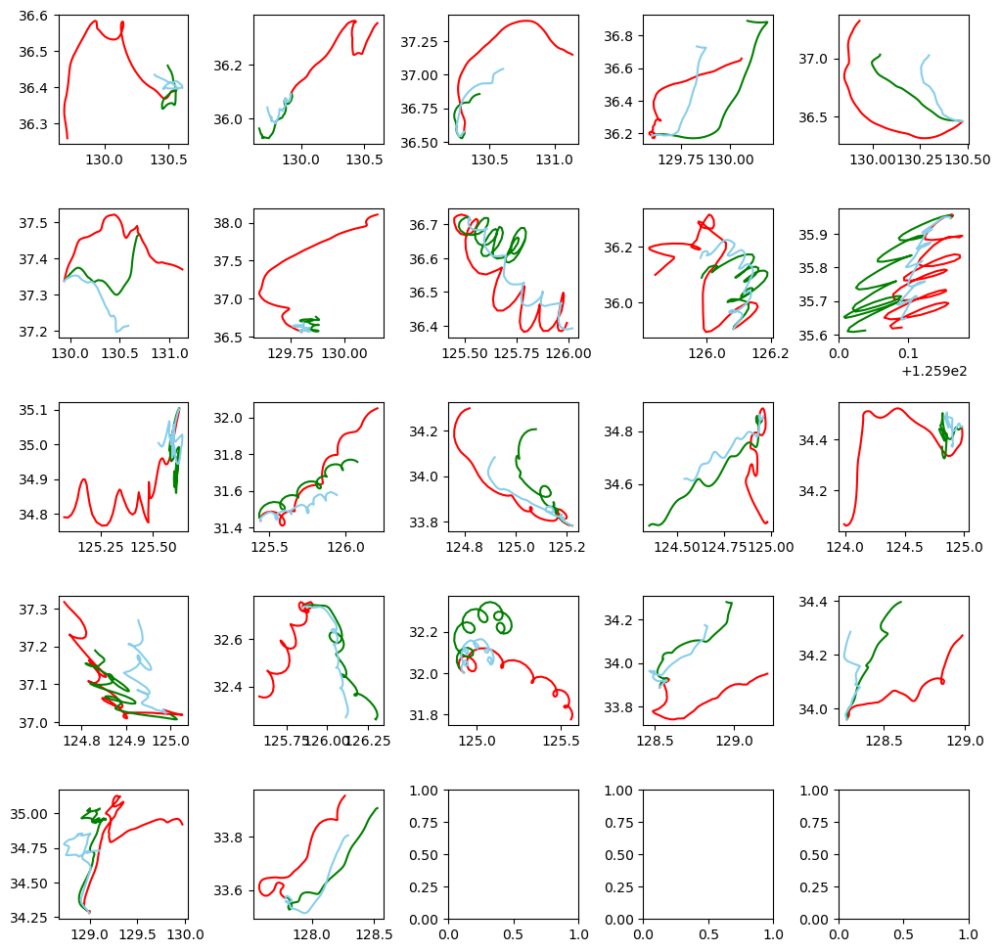

In [65]:
# lightgbm
import lightgbm as lgb
seed = 42
tf.keras.utils.set_random_seed(seed)
random.seed(seed)
np.random.seed(seed)
tf.random.set_seed(seed)
f, axes = plt.subplots(5, 5)
# 격자 크기 설정
f.set_size_inches((12, 12))
# 격자 여백 설정
plt.subplots_adjust(wspace = 0.5, hspace = 0.5)
baseline_MAE_list = list() 
baseline_NCLS_list = list()
MAE_list = list()
NCLS_list = list()
test_case_list = list()

for i in range(len(dataset)):
    # train dataset
    train_X = pd.DataFrame()
    train_y = np.array([[]])
    train = dataset[0:i] + dataset[i+1:len(dataset)]
    
    AE_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
    train_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    train_y = train[0][['diff_lon', 'diff_lat']]
    # 첫 행은 훈련에서 제외
    AE_X = AE_X[1:]
    train_X = train_X[1:]
    train_y = train_y[1:].to_numpy()
    
    for j in range(1,len(train)):
        add = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = train[j][['diff_lon', 'diff_lat']]
        add = add[1:]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
        
    # 과거 데이터 훈련데이터에 추가
    for k in range(len(only_train_dataset)):
        add =  only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = only_train_dataset[k][['diff_lon', 'diff_lat']]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        add = add[1:]
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
    
    # Test dataset
    test = dataset[i]
    start_lon = dataset[i]['start_lon'][0]
    start_lat = dataset[i]['start_lat'][0]
    test_X = test[['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    test_X = test_X[1:]
    test_y = test[['diff_lon', 'diff_lat']]
    test_y = test_y[1:].to_numpy()
    
    
    latent_dim = 5
    AE_X = AE_X.to_numpy()
    autoencoder = Autoencoder(latent_dim)
    autoencoder.compile(optimizer='adam', loss='mse')
    autoencoder.fit(AE_X,AE_X,
                    epochs=150,
                    shuffle=True)
    encoded = autoencoder.encoder(AE_X).numpy()
    decoded = autoencoder.decoder(encoded).numpy()
    add_X = decoded[:,[0,1,2,3]]
    add_y = decoded[:,[4,5]]
    
    train_X = np.concatenate((train_X.to_numpy(),add_X), axis = 0)
    train_y = np.concatenate((train_y,add_y), axis = 0)
    
    
    # 행단위로 살펴보기
    test_case_df = dataset[i][['time', 'obs_x1_lon', 'obs_x1_lat', 'wind_y','wind_x','water_velocity_y','water_velocity_x','model_x2_lon', 'model_x2_lat']]
    test_case_df['rf_lon'] = start_lon
    test_case_df['rf_lat'] = start_lat
    test_case_df['ncls_model'] = 0
    test_case_df['ncls_rf'] = 0
    
    # lightgbm 모델 생성
    lightgb_lon = lgb.LGBMRegressor(objective='regression',num_leaves=5,
                              learning_rate=0.009, n_estimators=270,max_depth=4
                              )
    lightgb_lat = lgb.LGBMRegressor(objective='regression',num_leaves=5,
                              learning_rate=0.009, n_estimators=270,max_depth=4
                            )
    
    # lightgbm 모델 훈련
    lightgb_lon.fit(train_X, train_y[:,0])
    lightgb_lat.fit(train_X, train_y[:,1])
    
    # Predict
    y_pred_lon = lightgb_lon.predict(test_X)
    y_pred_lat = lightgb_lat.predict(test_X)
    y_pred_lon = y_pred_lon.reshape((len(y_pred_lon),1))
    y_pred_lat = y_pred_lat.reshape((len(y_pred_lat),1))
    y_pred = np.concatenate((y_pred_lon,y_pred_lat),axis = 1)
    # case 별로 이상행 탐색
    for k in range(1,len(test_case_df)-1):
        test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
        test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
        test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
        test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
    
    test_case_df['rf_diff_lon'] = test_case_df['rf_lon'].diff()
    test_case_df['rf_diff_lon'][0] = 0
    test_case_df['rf_diff_lat'] = test_case_df['rf_lat'].diff()  
    test_case_df['rf_diff_lat'][0] = 0
    test_case_df['model_diff_lon'] = test_case_df['model_x2_lon'].diff() 
    test_case_df['model_diff_lon'][0] = 0
    test_case_df['model_diff_lat'] = test_case_df['model_x2_lat'].diff()
    test_case_df['model_diff_lat'][0] = 0
    test_case_list.append(test_case_df)
    
    # Plot
    lon, lat, baseline_lon, baseline_lat, lon_pred, lat_pred = drift_trajection_show(i,y_pred)
    row = i//5
    col = i%5
    axes[row][col].plot(lon, lat,'r-' ,baseline_lon, baseline_lat, 'g-', lon_pred, lat_pred, 'skyblue')   
    
    # evaluation 
    y = np.concatenate((lon.reshape((lon.shape[0],1)), lat.reshape((lat.shape[0],1))),axis = 1)
    pred = np.concatenate((lon_pred.reshape((lon_pred.shape[0],1)), lat_pred.reshape((lat_pred.shape[0],1))),axis =1)
    baseline_pred = np.concatenate((baseline_lon.reshape((baseline_lon.shape[0],1)), baseline_lat.reshape((baseline_lat.shape[0],1))),axis =1)
    
    #mae
    MAE_list.append(drift_mae(y, pred))
    baseline_MAE_list.append(drift_mae(y, baseline_pred))
    
    #NCLS
    NCLS_list.append(NCLS_score(y, pred))
    baseline_NCLS_list.append(NCLS_score(y, baseline_pred))
    
    for i in range(len(MAE_list)):
        print('------------------------ Model ', i+1, '------------------------')
        print('baseline',str(i),' MAE : ',MAE_list[i])
        print('Model',str(i),' MAE : ', baseline_MAE_list[i])
        print('baseline',str(i),' NCLS : ',baseline_NCLS_list[i])
        print('Model',str(i),' NCLS : ', NCLS_list[i])

plt.show()

In [66]:
# lightgbm # 에포크 처리 
mae_sum = 0
baseline_mae_sum = 0
NCLS_sum = 0
baseline_NCLS_sum = 0

for i in range(len(dataset)):
    mae_sum += MAE_list[i]
    baseline_mae_sum += baseline_MAE_list[i]
    NCLS_sum += NCLS_list[i]
    baseline_NCLS_sum += baseline_NCLS_list[i]

# 라이브러리 Mae    
print ('Model Mae : ', mae_sum/len(dataset) )
print ('Baseline Mae : ', baseline_mae_sum/len(dataset) )
print ('Model NCLS : ', NCLS_sum/len(dataset) )
print ('Baseline NCLS : ', baseline_NCLS_sum/len(dataset) )

Model Mae :  0.175675661024869
Baseline Mae :  0.18057603746811715
Model NCLS :  0.5550712238615617
Baseline NCLS :  0.5326670971119444


In [72]:
class stack_Autoencoder(Model):
    def __init__(self, latent_dim):
        super(stack_Autoencoder, self).__init__()
        self.latent_dim = latent_dim   
        self.encoder = tf.keras.Sequential([
          Dense(units = latent_dim, input_dim = 6, activation='relu'),
          Dense(units = latent_dim//2, activation='relu')
        ])
        self.decoder = tf.keras.Sequential([
          Dense(units = latent_dim, input_dim = latent_dim//2, activation='relu'),
          Dense(6, activation='sigmoid')
        ])

    def call(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

Epoch 1/150
93/93 [==============================] - 1s 1ms/step - loss: 8.3042
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 8.1610
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 8.0203
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.9318
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.8509
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.8066
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.7754
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.7489
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.7246
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.7014
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.6798
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.6595
Epoch 13/150
93/93 [=================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
Epoch 1/150
93/93 [==============================] - 1s 1ms/step - loss: 8.4476
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 8.1153
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.8536
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.7062
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.6202
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.5410
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.4610
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3886
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3299
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
Epoch 1/150
93/93 [==============================] - 1s 1ms/step - loss: 8.4797
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 8.3987
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 8.3627
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 8.3259
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 8.2889
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 8.2529
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 8.2208
Epoch 8/150
93/93 [=====================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
Epoch 1/150
93/93 [==============================] - 1s 1ms/step - loss: 8.6332
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 8.5659
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 8.5418
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 8.5206
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
Epoch 1/150
93/93 [==============================] - 1s 1ms/step - loss: 8.6932
Epoch 2/150
93/93 [==============================] - 0s 2ms/step - loss: 8.3461
Epoch 3/150
93/93 [=====================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

93/93 [==============================] - 0s 1ms/step - loss: 7.0504
Epoch 83/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0504
Epoch 84/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0503
Epoch 85/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0503
Epoch 86/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0503
Epoch 87/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0503
Epoch 88/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0503
Epoch 89/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0502
Epoch 90/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0502
Epoch 91/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0502
Epoch 92/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0502
Epoch 93/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0501
Epoch 94/150
93/93 [=====================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

Epoch 69/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1215
Epoch 70/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1214
Epoch 71/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1213
Epoch 72/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1212
Epoch 73/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1211
Epoch 74/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1210
Epoch 75/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1209
Epoch 76/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1207
Epoch 77/150
93/93 [==============================] - 0s 2ms/step - loss: 7.1206
Epoch 78/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1205
Epoch 79/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1204
Epoch 80/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1204
Epoch 81/150
93/93 [========

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

Epoch 61/150
93/93 [==============================] - 0s 2ms/step - loss: 7.0714
Epoch 62/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0707
Epoch 63/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0702
Epoch 64/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0697
Epoch 65/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0693
Epoch 66/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0689
Epoch 67/150
93/93 [==============================] - 0s 2ms/step - loss: 7.0685
Epoch 68/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0682
Epoch 69/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0678
Epoch 70/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0676
Epoch 71/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0673
Epoch 72/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0670
Epoch 73/150
93/93 [========

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

93/93 [==============================] - 0s 1ms/step - loss: 7.0539
Epoch 54/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0538
Epoch 55/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0537
Epoch 56/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0536
Epoch 57/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0533
Epoch 58/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0529
Epoch 59/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0528
Epoch 60/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0527
Epoch 61/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0526
Epoch 62/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0526
Epoch 63/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0525
Epoch 64/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0525
Epoch 65/150
93/93 [=====================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

90/90 [==============================] - 0s 1ms/step - loss: 6.8600


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWith

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

93/93 [==============================] - 0s 1ms/step - loss: 7.0357
Epoch 148/150
93/93 [==============================] - 0s 2ms/step - loss: 7.0356
Epoch 149/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0357
Epoch 150/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0356


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3363625968.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26993229697894816
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2625755008770888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37140612412469803
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03470418447769874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2709215733644176
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4476034328200895
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.20082759732698874
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.08544114590964369
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.22053434528070315
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.514963292

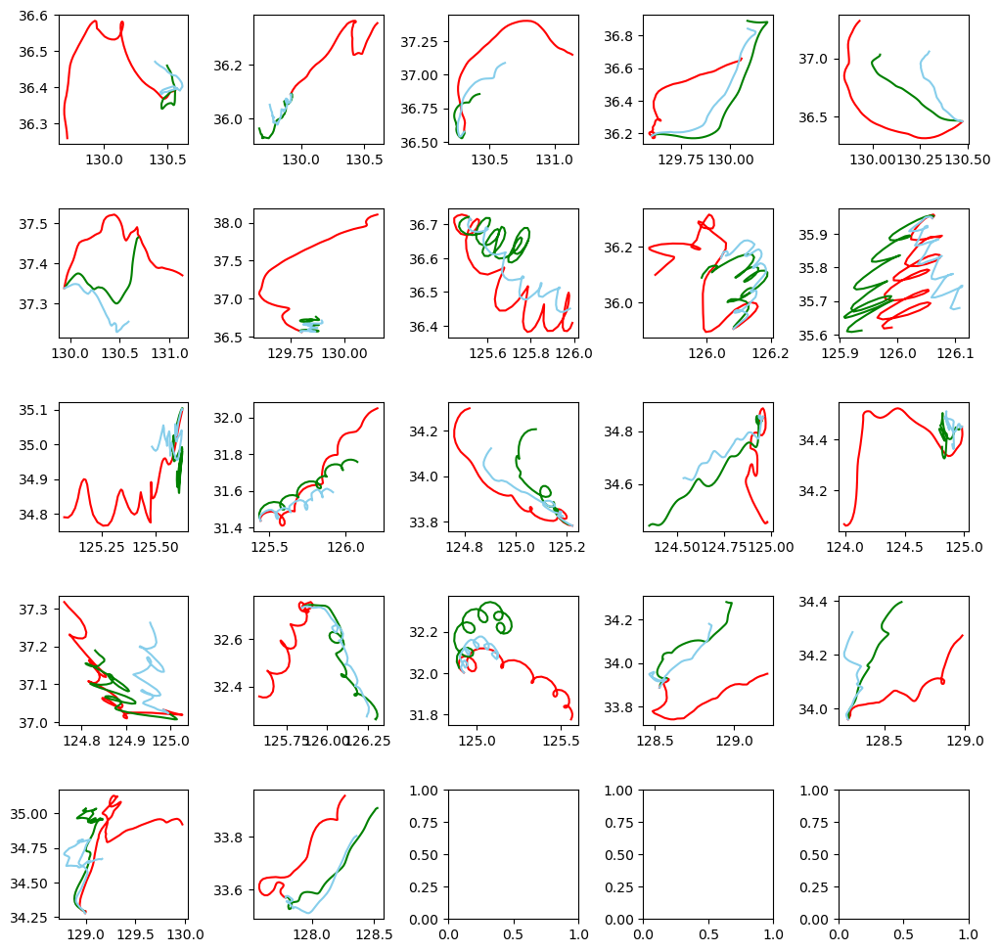

In [73]:
# lightgbm
import lightgbm as lgb
seed = 42
tf.keras.utils.set_random_seed(seed)
random.seed(seed)
np.random.seed(seed)
tf.random.set_seed(seed)
f, axes = plt.subplots(5, 5)
# 격자 크기 설정
f.set_size_inches((12, 12))
# 격자 여백 설정
plt.subplots_adjust(wspace = 0.5, hspace = 0.5)
baseline_MAE_list = list() 
baseline_NCLS_list = list()
MAE_list = list()
NCLS_list = list()
test_case_list = list()

for i in range(len(dataset)):
    # train dataset
    train_X = pd.DataFrame()
    train_y = np.array([[]])
    train = dataset[0:i] + dataset[i+1:len(dataset)]
    
    AE_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
    train_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    train_y = train[0][['diff_lon', 'diff_lat']]
    # 첫 행은 훈련에서 제외
    AE_X = AE_X[1:]
    train_X = train_X[1:]
    train_y = train_y[1:].to_numpy()
    
    for j in range(1,len(train)):
        add = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = train[j][['diff_lon', 'diff_lat']]
        add = add[1:]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
        
    # 과거 데이터 훈련데이터에 추가
    for k in range(len(only_train_dataset)):
        add =  only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = only_train_dataset[k][['diff_lon', 'diff_lat']]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        add = add[1:]
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
    
    # Test dataset
    test = dataset[i]
    start_lon = dataset[i]['start_lon'][0]
    start_lat = dataset[i]['start_lat'][0]
    test_X = test[['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    test_X = test_X[1:]
    test_y = test[['diff_lon', 'diff_lat']]
    test_y = test_y[1:].to_numpy()
    
    
    latent_dim = 5
    AE_X = AE_X.to_numpy()
    autoencoder = stack_Autoencoder(latent_dim)
    autoencoder.compile(optimizer='adam', loss='mse')
    autoencoder.fit(AE_X,AE_X,
                    epochs=150,
                    shuffle=True)
    encoded = autoencoder.encoder(AE_X).numpy()
    decoded = autoencoder.decoder(encoded).numpy()
    add_X = decoded[:,[0,1,2,3]]
    add_y = decoded[:,[4,5]]
    
    train_X = np.concatenate((train_X.to_numpy(),add_X), axis = 0)
    train_y = np.concatenate((train_y,add_y), axis = 0)
    
    
    # 행단위로 살펴보기
    test_case_df = dataset[i][['time', 'obs_x1_lon', 'obs_x1_lat', 'wind_y','wind_x','water_velocity_y','water_velocity_x','model_x2_lon', 'model_x2_lat']]
    test_case_df['rf_lon'] = start_lon
    test_case_df['rf_lat'] = start_lat
    test_case_df['ncls_model'] = 0
    test_case_df['ncls_rf'] = 0
    
    # lightgbm 모델 생성
    lightgb_lon = lgb.LGBMRegressor(objective='regression',num_leaves=5,
                              learning_rate=0.009, n_estimators=270,max_depth=4
                              )
    lightgb_lat = lgb.LGBMRegressor(objective='regression',num_leaves=5,
                              learning_rate=0.009, n_estimators=270,max_depth=4
                            )
    
    # lightgbm 모델 훈련
    lightgb_lon.fit(train_X, train_y[:,0])
    lightgb_lat.fit(train_X, train_y[:,1])
    
    # Predict
    y_pred_lon = lightgb_lon.predict(test_X)
    y_pred_lat = lightgb_lat.predict(test_X)
    y_pred_lon = y_pred_lon.reshape((len(y_pred_lon),1))
    y_pred_lat = y_pred_lat.reshape((len(y_pred_lat),1))
    y_pred = np.concatenate((y_pred_lon,y_pred_lat),axis = 1)
    # case 별로 이상행 탐색
    for k in range(1,len(test_case_df)-1):
        test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
        test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
        test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
        test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
    
    test_case_df['rf_diff_lon'] = test_case_df['rf_lon'].diff()
    test_case_df['rf_diff_lon'][0] = 0
    test_case_df['rf_diff_lat'] = test_case_df['rf_lat'].diff()  
    test_case_df['rf_diff_lat'][0] = 0
    test_case_df['model_diff_lon'] = test_case_df['model_x2_lon'].diff() 
    test_case_df['model_diff_lon'][0] = 0
    test_case_df['model_diff_lat'] = test_case_df['model_x2_lat'].diff()
    test_case_df['model_diff_lat'][0] = 0
    test_case_list.append(test_case_df)
    
    # Plot
    lon, lat, baseline_lon, baseline_lat, lon_pred, lat_pred = drift_trajection_show(i,y_pred)
    row = i//5
    col = i%5
    axes[row][col].plot(lon, lat,'r-' ,baseline_lon, baseline_lat, 'g-', lon_pred, lat_pred, 'skyblue')   
    
    # evaluation 
    y = np.concatenate((lon.reshape((lon.shape[0],1)), lat.reshape((lat.shape[0],1))),axis = 1)
    pred = np.concatenate((lon_pred.reshape((lon_pred.shape[0],1)), lat_pred.reshape((lat_pred.shape[0],1))),axis =1)
    baseline_pred = np.concatenate((baseline_lon.reshape((baseline_lon.shape[0],1)), baseline_lat.reshape((baseline_lat.shape[0],1))),axis =1)
    
    #mae
    MAE_list.append(drift_mae(y, pred))
    baseline_MAE_list.append(drift_mae(y, baseline_pred))
    
    #NCLS
    NCLS_list.append(NCLS_score(y, pred))
    baseline_NCLS_list.append(NCLS_score(y, baseline_pred))
    
    for i in range(len(MAE_list)):
        print('------------------------ Model ', i+1, '------------------------')
        print('baseline',str(i),' MAE : ',MAE_list[i])
        print('Model',str(i),' MAE : ', baseline_MAE_list[i])
        print('baseline',str(i),' NCLS : ',baseline_NCLS_list[i])
        print('Model',str(i),' NCLS : ', NCLS_list[i])

plt.show()

In [74]:
# lightgbm # 에포크 처리 
mae_sum = 0
baseline_mae_sum = 0
NCLS_sum = 0
baseline_NCLS_sum = 0

for i in range(len(dataset)):
    mae_sum += MAE_list[i]
    baseline_mae_sum += baseline_MAE_list[i]
    NCLS_sum += NCLS_list[i]
    baseline_NCLS_sum += baseline_NCLS_list[i]

# 라이브러리 Mae    
print ('Model Mae : ', mae_sum/len(dataset) )
print ('Baseline Mae : ', baseline_mae_sum/len(dataset) )
print ('Model NCLS : ', NCLS_sum/len(dataset) )
print ('Baseline NCLS : ', baseline_NCLS_sum/len(dataset) )

Model Mae :  0.18255348255525175
Baseline Mae :  0.18057603746811715
Model NCLS :  0.5279648798184264
Baseline NCLS :  0.5326670971119444


In [10]:
from tensorflow.keras.models import Model
from sklearn.metrics import mean_absolute_error
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.activations import relu
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import mean_absolute_error

class Autoencoder(Model):
    def __init__(self, latent_dim):
        super(Autoencoder, self).__init__()
        self.latent_dim = latent_dim   
        self.encoder = tf.keras.Sequential([
          Dense(units = latent_dim, input_dim = 6, activation='relu'),
        ])
        self.decoder = tf.keras.Sequential([
          Dense(units = 6)
        ])

    def call(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

Epoch 1/150
93/93 [==============================] - 0s 973us/step - loss: 8.1688
Epoch 2/150
93/93 [==============================] - 0s 973us/step - loss: 7.5009
Epoch 3/150
93/93 [==============================] - 0s 995us/step - loss: 7.1593
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0942
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0667
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0509
Epoch 7/150
93/93 [==============================] - 0s 937us/step - loss: 7.0405
Epoch 8/150
93/93 [==============================] - 0s 973us/step - loss: 7.0331
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0275
Epoch 10/150
93/93 [==============================] - 0s 940us/step - loss: 7.0234
Epoch 11/150
93/93 [==============================] - 0s 967us/step - loss: 7.0202
Epoch 12/150
93/93 [==============================] - 0s 995us/step - loss: 7.0175
Epoch 13/150
93/93 [=

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:107: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
Epoch 1/150
93/93 [==============================] - 0s 962us/step - loss: 8.3863
Epoch 2/150
93/93 [==============================] - 0s 984us/step - loss: 7.5750
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3591
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2795
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2439
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2235
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2102
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2008
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1942
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - lo

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
Epoch 1/150


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:106: SettingWith

93/93 [==============================] - 0s 1ms/step - loss: 7.9987
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3406
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1784
Epoch 4/150
93/93 [==============================] - 0s 995us/step - loss: 7.1206
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0901
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0711
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0584
Epoch 8/150
93/93 [==============================] - 0s 995us/step - loss: 7.0494
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0427
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0375
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0335
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0304
Epoch 13/150
93/93 [=========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
Epoch 1/150


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:106: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:107: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

93/93 [==============================] - 0s 870us/step - loss: 7.9956
Epoch 2/150
93/93 [==============================] - 0s 940us/step - loss: 7.4142
Epoch 3/150
93/93 [==============================] - 0s 973us/step - loss: 7.2752
Epoch 4/150
93/93 [==============================] - 0s 973us/step - loss: 7.2238
Epoch 5/150
93/93 [==============================] - 0s 951us/step - loss: 7.1989
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1844
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1751
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1688
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1641
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1607
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1580
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1558
Epoch 13/150
93/93 [===================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:106: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
Epoch 1/150
93/93 [==============================] - 0s 1ms/step - loss: 8.2125
Epoch 2/150
93/93 [==============================] - 0s 2ms/step - loss: 7.4229
Epoch 3/150
93/93 [=========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:107: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



93/93 [==============================] - 0s 963us/step - loss: 7.5530
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1263
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0355
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9986
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9787
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9667
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9587
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9530
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9488
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9455
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9428
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9406
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:106: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:107: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

93/93 [==============================] - 1s 1ms/step - loss: 7.7473
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1155
Epoch 3/150
93/93 [==============================] - 0s 2ms/step - loss: 6.9561
Epoch 4/150
93/93 [==============================] - 0s 3ms/step - loss: 6.9007
Epoch 5/150
93/93 [==============================] - 0s 2ms/step - loss: 6.8733
Epoch 6/150
93/93 [==============================] - 0s 2ms/step - loss: 6.8571
Epoch 7/150
93/93 [==============================] - 0s 2ms/step - loss: 6.8465
Epoch 8/150
93/93 [==============================] - 0s 2ms/step - loss: 6.8391
Epoch 9/150
93/93 [==============================] - 0s 2ms/step - loss: 6.8336
Epoch 10/150
93/93 [==============================] - 0s 2ms/step - loss: 6.8295
Epoch 11/150
93/93 [==============================] - 0s 2ms/step - loss: 6.8263
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8237
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:106: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:107: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

93/93 [==============================] - 0s 995us/step - loss: 7.8598
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3331
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2068
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1506
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1203
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1022
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0907
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0827
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0769
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0724
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0690
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0663
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:106: SettingWith

93/93 [==============================] - 0s 908us/step - loss: 8.2868
Epoch 2/150
93/93 [==============================] - 0s 935us/step - loss: 7.4910
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2326
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1729
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1467
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1317
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1219
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1150
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1098
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1058
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1026
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1000
Epoch 13/150
93/93 [=========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:106: SettingWith

93/93 [==============================] - 1s 880us/step - loss: 8.1162
Epoch 2/150
93/93 [==============================] - 0s 973us/step - loss: 7.4188
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2338
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1664
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1358
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1188
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1084
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1015
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0966
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0930
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0901
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0879
Epoch 13/150
93/93 [=========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:106: SettingWith

93/93 [==============================] - 0s 1ms/step - loss: 7.7639
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3458
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2372
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1959
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1748
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1623
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1541
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1483
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1440
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1407
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1381
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1358
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:106: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:107: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

93/93 [==============================] - 0s 978us/step - loss: 7.5140
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1412
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0450
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0031
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9821
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9706
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9636
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9589
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9555
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9530
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9510
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9494
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:107: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



93/93 [==============================] - 0s 951us/step - loss: 8.3189
Epoch 2/150
93/93 [==============================] - 0s 940us/step - loss: 7.5730
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3309
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2439
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2043
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1822
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1685
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1591
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1525
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1475
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1437
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1407
Epoch 13/150
93/93 [=========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:107: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



93/93 [==============================] - 0s 850us/step - loss: 8.5814
Epoch 2/150
93/93 [==============================] - 0s 897us/step - loss: 7.5295
Epoch 3/150
93/93 [==============================] - 0s 962us/step - loss: 7.2978
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2260
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1920
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1719
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1592
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1504
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1440
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1392
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1353
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1321
Epoch 13/150
93/93 [=======================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

93/93 [==============================] - 0s 1ms/step - loss: 7.0546
Epoch 62/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0545
Epoch 63/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0545
Epoch 64/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0544
Epoch 65/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0544
Epoch 66/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0543
Epoch 67/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0543
Epoch 68/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0543
Epoch 69/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0543
Epoch 70/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0542
Epoch 71/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0542
Epoch 72/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0542
Epoch 73/150
93/93 [=====================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:107: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



93/93 [==============================] - 0s 853us/step - loss: 8.1263
Epoch 2/150
93/93 [==============================] - 0s 924us/step - loss: 7.4526
Epoch 3/150
93/93 [==============================] - 0s 995us/step - loss: 7.2784
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2221
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1941
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1776
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1668
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1593
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1538
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1496
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1463
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1437
Epoch 13/150
93/93 [=======================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:106: SettingWith

93/93 [==============================] - 0s 844us/step - loss: 8.1578
Epoch 2/150
93/93 [==============================] - 0s 891us/step - loss: 7.3730
Epoch 3/150
93/93 [==============================] - 0s 962us/step - loss: 7.1450
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0689
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0335
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0134
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0004
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9917
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9854
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9806
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9770
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9740
Epoch 13/150
93/93 [=======================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:106: SettingWith

93/93 [==============================] - 0s 888us/step - loss: 7.9458
Epoch 2/150
93/93 [==============================] - 0s 908us/step - loss: 7.3146
Epoch 3/150
93/93 [==============================] - 0s 995us/step - loss: 7.1868
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1380
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1128
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0977
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0879
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0810
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0761
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0724
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0694
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0671
Epoch 13/150
93/93 [=======================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:107: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:109: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



90/90 [==============================] - 0s 848us/step - loss: 8.0257
Epoch 2/150
90/90 [==============================] - 0s 933us/step - loss: 7.2997
Epoch 3/150
90/90 [==============================] - 0s 1ms/step - loss: 7.0275
Epoch 4/150
90/90 [==============================] - 0s 1ms/step - loss: 6.9608
Epoch 5/150
90/90 [==============================] - 0s 1ms/step - loss: 6.9302
Epoch 6/150
90/90 [==============================] - 0s 1ms/step - loss: 6.9127
Epoch 7/150
90/90 [==============================] - 0s 1ms/step - loss: 6.9015
Epoch 8/150
90/90 [==============================] - 0s 1ms/step - loss: 6.8937
Epoch 9/150
90/90 [==============================] - 0s 1ms/step - loss: 6.8880
Epoch 10/150
90/90 [==============================] - 0s 1ms/step - loss: 6.8837
Epoch 11/150
90/90 [==============================] - 0s 1ms/step - loss: 6.8803
Epoch 12/150
90/90 [==============================] - 0s 1ms/step - loss: 6.8775
Epoch 13/150
90/90 [=========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:106: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:107: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

93/93 [==============================] - 0s 1ms/step - loss: 7.0268
Epoch 148/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0268
Epoch 149/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0268
Epoch 150/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0268


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:81: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2820482911.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2616124595572987
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.285973202484915
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3789454140041558
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.010146344576526412
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2839122404872841
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4298720690340976
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.0939194245431926
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5705155616945659
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20751290962649127
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5397233062039

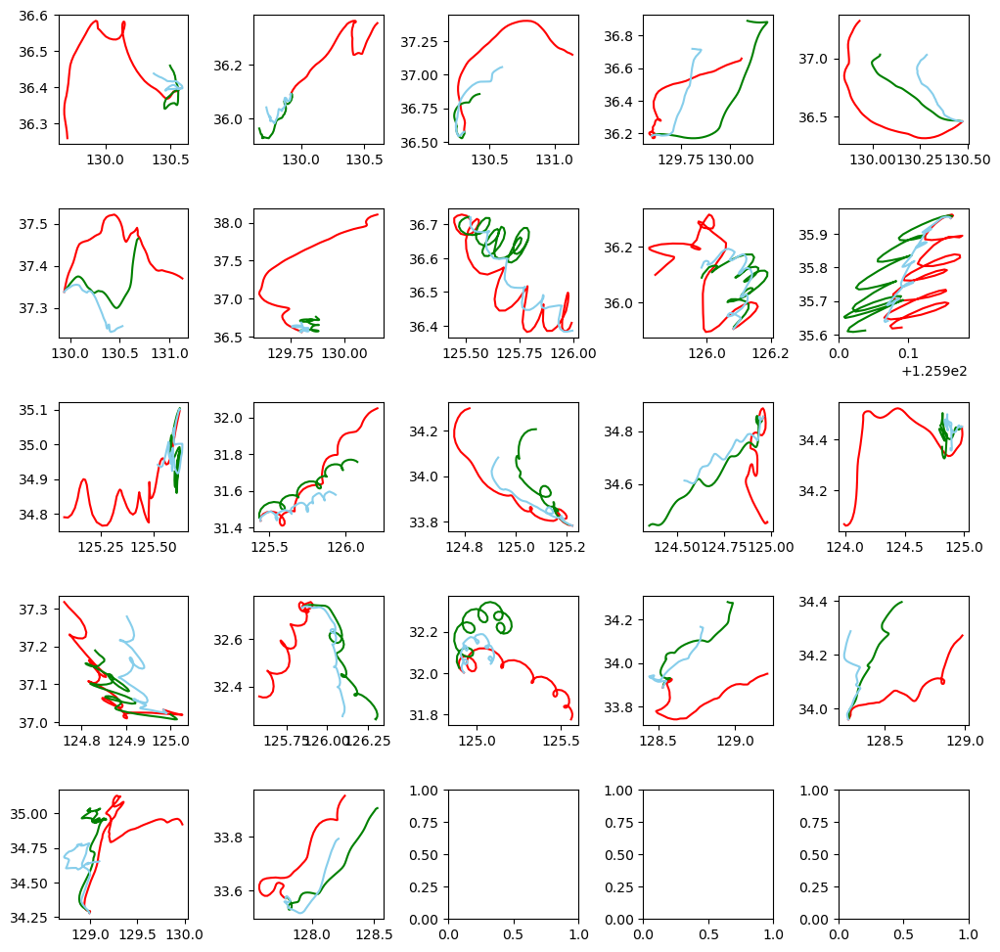

In [12]:
# lightgbm
import lightgbm as lgb
f, axes = plt.subplots(5, 5)
# 격자 크기 설정
f.set_size_inches((12, 12))
# 격자 여백 설정
plt.subplots_adjust(wspace = 0.5, hspace = 0.5)
baseline_MAE_list = list() 
baseline_NCLS_list = list()
MAE_list = list()
NCLS_list = list()
test_case_list = list()

for i in range(len(dataset)):
    # train dataset
    train_X = pd.DataFrame()
    train_y = np.array([[]])
    train = dataset[0:i] + dataset[i+1:len(dataset)]
    
    AE_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
    train_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    train_y = train[0][['diff_lon', 'diff_lat']]
    # 첫 행은 훈련에서 제외
    AE_X = AE_X[1:]
    train_X = train_X[1:]
    train_y = train_y[1:].to_numpy()
    
    for j in range(1,len(train)):
        add = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = train[j][['diff_lon', 'diff_lat']]
        add = add[1:]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
        
    # 과거 데이터 훈련데이터에 추가
    for k in range(len(only_train_dataset)):
        add =  only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = only_train_dataset[k][['diff_lon', 'diff_lat']]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        add = add[1:]
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
    
    # Test dataset
    test = dataset[i]
    start_lon = dataset[i]['start_lon'][0]
    start_lat = dataset[i]['start_lat'][0]
    test_X = test[['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    test_X = test_X[1:]
    test_y = test[['diff_lon', 'diff_lat']]
    test_y = test_y[1:].to_numpy()
    
    
    latent_dim = 20
    AE_X = AE_X.to_numpy()
    autoencoder = Autoencoder(latent_dim)
    autoencoder.compile(optimizer='adam', loss='mse')
    autoencoder.fit(AE_X,AE_X,
                    epochs=150,
                    shuffle=True)
    encoded = autoencoder.encoder(AE_X).numpy()
    decoded = autoencoder.decoder(encoded).numpy()
    add_X = decoded[:,[0,1,2,3]]
    add_y = decoded[:,[4,5]]
    
    train_X = np.concatenate((train_X.to_numpy(),add_X), axis = 0)
    train_y = np.concatenate((train_y,add_y), axis = 0)
    
    
    # 행단위로 살펴보기
    test_case_df = dataset[i][['time', 'obs_x1_lon', 'obs_x1_lat', 'wind_y','wind_x','water_velocity_y','water_velocity_x','model_x2_lon', 'model_x2_lat']]
    test_case_df['rf_lon'] = start_lon
    test_case_df['rf_lat'] = start_lat
    test_case_df['ncls_model'] = 0
    test_case_df['ncls_rf'] = 0
    
    # lightgbm 모델 생성
    lightgb_lon = lgb.LGBMRegressor(objective='regression',num_leaves=5,
                              learning_rate=0.009, n_estimators=270,max_depth=4
                              )
    lightgb_lat = lgb.LGBMRegressor(objective='regression',num_leaves=5,
                              learning_rate=0.009, n_estimators=270,max_depth=4
                            )
    
    # lightgbm 모델 훈련
    lightgb_lon.fit(train_X, train_y[:,0])
    lightgb_lat.fit(train_X, train_y[:,1])
    
    # Predict
    y_pred_lon = lightgb_lon.predict(test_X)
    y_pred_lat = lightgb_lat.predict(test_X)
    y_pred_lon = y_pred_lon.reshape((len(y_pred_lon),1))
    y_pred_lat = y_pred_lat.reshape((len(y_pred_lat),1))
    y_pred = np.concatenate((y_pred_lon,y_pred_lat),axis = 1)
    # case 별로 이상행 탐색
    for k in range(1,len(test_case_df)-1):
        test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
        test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
        test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
        test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
    
    test_case_df['rf_diff_lon'] = test_case_df['rf_lon'].diff()
    test_case_df['rf_diff_lon'][0] = 0
    test_case_df['rf_diff_lat'] = test_case_df['rf_lat'].diff()  
    test_case_df['rf_diff_lat'][0] = 0
    test_case_df['model_diff_lon'] = test_case_df['model_x2_lon'].diff() 
    test_case_df['model_diff_lon'][0] = 0
    test_case_df['model_diff_lat'] = test_case_df['model_x2_lat'].diff()
    test_case_df['model_diff_lat'][0] = 0
    test_case_list.append(test_case_df)
    
    # Plot
    lon, lat, baseline_lon, baseline_lat, lon_pred, lat_pred = drift_trajection_show(i,y_pred)
    row = i//5
    col = i%5
    axes[row][col].plot(lon, lat,'r-' ,baseline_lon, baseline_lat, 'g-', lon_pred, lat_pred, 'skyblue')   
    
    # evaluation 
    y = np.concatenate((lon.reshape((lon.shape[0],1)), lat.reshape((lat.shape[0],1))),axis = 1)
    pred = np.concatenate((lon_pred.reshape((lon_pred.shape[0],1)), lat_pred.reshape((lat_pred.shape[0],1))),axis =1)
    baseline_pred = np.concatenate((baseline_lon.reshape((baseline_lon.shape[0],1)), baseline_lat.reshape((baseline_lat.shape[0],1))),axis =1)
    
    #mae
    MAE_list.append(drift_mae(y, pred))
    baseline_MAE_list.append(drift_mae(y, baseline_pred))
    
    #NCLS
    NCLS_list.append(NCLS_score(y, pred))
    baseline_NCLS_list.append(NCLS_score(y, baseline_pred))
    
    for i in range(len(MAE_list)):
        print('------------------------ Model ', i+1, '------------------------')
        print('baseline',str(i),' MAE : ',MAE_list[i])
        print('Model',str(i),' MAE : ', baseline_MAE_list[i])
        print('baseline',str(i),' NCLS : ',baseline_NCLS_list[i])
        print('Model',str(i),' NCLS : ', NCLS_list[i])

plt.show()

In [13]:
# lightgbm # 에포크 처리 
mae_sum = 0
baseline_mae_sum = 0
NCLS_sum = 0
baseline_NCLS_sum = 0

for i in range(len(dataset)):
    mae_sum += MAE_list[i]
    baseline_mae_sum += baseline_MAE_list[i]
    NCLS_sum += NCLS_list[i]
    baseline_NCLS_sum += baseline_NCLS_list[i]

# 라이브러리 Mae    
print ('Model Mae : ', mae_sum/len(dataset) )
print ('Baseline Mae : ', baseline_mae_sum/len(dataset) )
print ('Model NCLS : ', NCLS_sum/len(dataset) )
print ('Baseline NCLS : ', baseline_NCLS_sum/len(dataset) )

Model Mae :  0.17578254659164474
Baseline Mae :  0.18057603746811715
Model NCLS :  0.5591214889088514
Baseline NCLS :  0.5326670971119444


In [23]:
from tensorflow.keras.models import Model
from sklearn.metrics import mean_absolute_error
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.activations import relu
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import mean_absolute_error

class Autoencoder(Model):
    def __init__(self, latent_dim):
        super(Autoencoder, self).__init__()
        self.latent_dim = latent_dim   
        self.encoder = tf.keras.Sequential([
          Dense(units = latent_dim, input_dim = 6, activation='relu'),
        ])
        self.decoder = tf.keras.Sequential([
          Dense(units = 6, activation='sigmoid')
        ])

    def call(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

Epoch 1/150
93/93 [==============================] - 1s 951us/step - loss: 8.5589
Epoch 2/150
93/93 [==============================] - 0s 924us/step - loss: 7.5268
Epoch 3/150
93/93 [==============================] - 0s 973us/step - loss: 7.2339
Epoch 4/150
93/93 [==============================] - 0s 973us/step - loss: 7.1395
Epoch 5/150
93/93 [==============================] - 0s 995us/step - loss: 7.0965
Epoch 6/150
93/93 [==============================] - 0s 957us/step - loss: 7.0726
Epoch 7/150
93/93 [==============================] - 0s 962us/step - loss: 7.0574
Epoch 8/150
93/93 [==============================] - 0s 973us/step - loss: 7.0469
Epoch 9/150
93/93 [==============================] - 0s 984us/step - loss: 7.0391
Epoch 10/150
93/93 [==============================] - 0s 984us/step - loss: 7.0332
Epoch 11/150
93/93 [==============================] - 0s 995us/step - loss: 7.0285
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0247
Epoch 13/150
93

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
Epoch 1/150


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

93/93 [==============================] - 1s 965us/step - loss: 8.1613
Epoch 2/150
93/93 [==============================] - 0s 973us/step - loss: 7.4991
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3300
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2664
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2354
Epoch 6/150
93/93 [==============================] - 0s 973us/step - loss: 7.2175
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2060
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1978
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1919
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1873
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1837
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1808
Epoch 13/150
93/93 [=======================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
Epoch 1/150


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

93/93 [==============================] - 0s 902us/step - loss: 8.0238
Epoch 2/150
93/93 [==============================] - 0s 929us/step - loss: 7.3271
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1727
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1169
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0843
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0648
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0524
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0439
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0379
Epoch 10/150
93/93 [==============================] - 0s 973us/step - loss: 7.0333
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0298
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0270
Epoch 13/150
93/93 [=======================

Epoch 102/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9979
Epoch 103/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9979
Epoch 104/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9979
Epoch 105/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9979
Epoch 106/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9979
Epoch 107/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9979
Epoch 108/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9979
Epoch 109/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9979
Epoch 110/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9979
Epoch 111/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9980
Epoch 112/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9979
Epoch 113/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9979
Epoch 114/150
93

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
Epoch 1/150


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



93/93 [==============================] - 0s 973us/step - loss: 8.2921
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.5932
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3465
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2595
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2221
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2013
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1883
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1795
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1733
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1686
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1650
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1621
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
Epoch 1/150
93/93 [==============================] - 0s 940us/step - loss: 7.9235
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3310
Epoch 3/150
93/93 [===================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



93/93 [==============================] - 0s 886us/step - loss: 8.0441
Epoch 2/150
93/93 [==============================] - 0s 957us/step - loss: 7.4308
Epoch 3/150
93/93 [==============================] - 0s 978us/step - loss: 7.2618
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2104
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1864
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1723
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1633
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1569
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1522
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1486
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1457
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1433
Epoch 13/150
93/93 [=======================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

93/93 [==============================] - 0s 924us/step - loss: 7.6300
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2626
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1582
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1191
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0988
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0867
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0789
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0734
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0694
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0662
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0637
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0616
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

93/93 [==============================] - 0s 886us/step - loss: 7.6761
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2778
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1917
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1566
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1374
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1253
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1171
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1111
Epoch 9/150
93/93 [==============================] - 0s 2ms/step - loss: 7.1064
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1027
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0997
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0972
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWith

93/93 [==============================] - 0s 1ms/step - loss: 8.5571
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.7004
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2853
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1807
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1429
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1236
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1121
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1043
Epoch 9/150
93/93 [==============================] - 0s 2ms/step - loss: 7.0988
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0947
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0914
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0888
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWith

93/93 [==============================] - 0s 919us/step - loss: 8.0078
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.4941
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2851
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2123
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1820
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1658
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1560
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1494
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1446
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1410
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1383
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1359
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

93/93 [==============================] - 1s 924us/step - loss: 7.8527
Epoch 2/150
93/93 [==============================] - 0s 951us/step - loss: 7.2458
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0787
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0247
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9992
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9846
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9754
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9690
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9644
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9608
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9580
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9557
Epoch 13/150
93/93 [=========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWith

93/93 [==============================] - 0s 886us/step - loss: 7.8823
Epoch 2/150
93/93 [==============================] - 0s 962us/step - loss: 7.3235
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2262
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1885
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1691
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1573
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1497
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1443
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1404
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1373
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1350
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1330
Epoch 13/150
93/93 [=========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWith

93/93 [==============================] - 0s 1ms/step - loss: 8.1149
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3812
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2238
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1680
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1400
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1236
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1130
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1057
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1004
Epoch 10/150
93/93 [==============================] - 0s 2ms/step - loss: 7.0963
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0932
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0907
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



93/93 [==============================] - 0s 897us/step - loss: 7.6121
Epoch 2/150
93/93 [==============================] - 0s 984us/step - loss: 7.2475
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1642
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1301
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1115
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1001
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0927
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0876
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0839
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0810
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0788
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0769
Epoch 13/150
93/93 [=========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

93/93 [==============================] - 0s 942us/step - loss: 8.2715
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.5457
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3203
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2431
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2065
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1858
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1729
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1639
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1576
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1529
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1493
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1463
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWith

93/93 [==============================] - 0s 1ms/step - loss: 7.6419
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2841
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1649
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1228
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1026
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0906
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0827
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0771
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0729
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0696
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0669
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0648
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

90/90 [==============================] - 0s 916us/step - loss: 7.3973
Epoch 2/150
90/90 [==============================] - 0s 986us/step - loss: 7.1055
Epoch 3/150
90/90 [==============================] - 0s 1ms/step - loss: 6.9741
Epoch 4/150
90/90 [==============================] - 0s 1ms/step - loss: 6.9239
Epoch 5/150
90/90 [==============================] - 0s 1ms/step - loss: 6.9022
Epoch 6/150
90/90 [==============================] - 0s 1ms/step - loss: 6.8908
Epoch 7/150
90/90 [==============================] - 0s 1ms/step - loss: 6.8839
Epoch 8/150
90/90 [==============================] - 0s 1ms/step - loss: 6.8792
Epoch 9/150
90/90 [==============================] - 0s 1ms/step - loss: 6.8758
Epoch 10/150
90/90 [==============================] - 0s 1ms/step - loss: 6.8732
Epoch 11/150
90/90 [==============================] - 0s 1ms/step - loss: 6.8712
Epoch 12/150
90/90 [==============================] - 0s 1ms/step - loss: 6.8695
Epoch 13/150
90/90 [=========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWith

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:111: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

93/93 [==============================] - 0s 1ms/step - loss: 7.0275
Epoch 148/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0275
Epoch 149/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0275
Epoch 150/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0275


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\3269529728.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

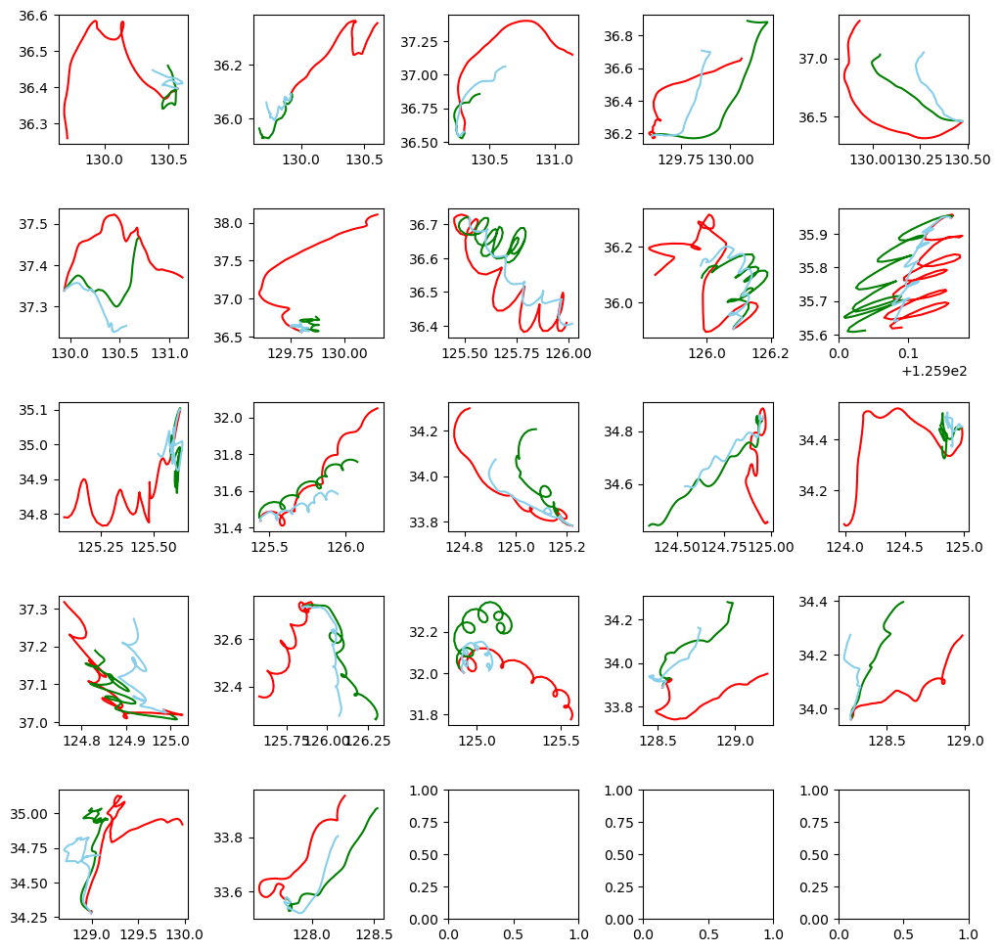

In [24]:

import lightgbm as lgb
seed = 42
tf.keras.utils.set_random_seed(seed)
random.seed(seed)
np.random.seed(seed)
tf.random.set_seed(seed)

f, axes = plt.subplots(5, 5)
# 격자 크기 설정
f.set_size_inches((12, 12))
# 격자 여백 설정
plt.subplots_adjust(wspace = 0.5, hspace = 0.5)
baseline_MAE_list = list() 
baseline_NCLS_list = list()
MAE_list = list()
NCLS_list = list()
test_case_list = list()

for i in range(len(dataset)):
    # train dataset
    train_X = pd.DataFrame()
    train_y = np.array([[]])
    train = dataset[0:i] + dataset[i+1:len(dataset)]
    
    AE_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
    train_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    train_y = train[0][['diff_lon', 'diff_lat']]
    # 첫 행은 훈련에서 제외
    AE_X = AE_X[1:]
    train_X = train_X[1:]
    train_y = train_y[1:].to_numpy()
    
    for j in range(1,len(train)):
        add = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = train[j][['diff_lon', 'diff_lat']]
        add = add[1:]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
        
    # 과거 데이터 훈련데이터에 추가
    for k in range(len(only_train_dataset)):
        add =  only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = only_train_dataset[k][['diff_lon', 'diff_lat']]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        add = add[1:]
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
    
    # Test dataset
    test = dataset[i]
    start_lon = dataset[i]['start_lon'][0]
    start_lat = dataset[i]['start_lat'][0]
    test_X = test[['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    test_X = test_X[1:]
    test_y = test[['diff_lon', 'diff_lat']]
    test_y = test_y[1:].to_numpy()
    
    
    latent_dim = 20
    AE_X = AE_X.to_numpy()
    autoencoder = Autoencoder(latent_dim)
    autoencoder.compile(optimizer='adam', loss='mse')
    autoencoder.fit(AE_X,AE_X,
                    epochs=150,
                    shuffle=True)
    encoded = autoencoder.encoder(AE_X).numpy()
    decoded = autoencoder.decoder(encoded).numpy()
    add_X = decoded[:,[0,1,2,3]]
    add_y = decoded[:,[4,5]]
    
    train_X = np.concatenate((train_X.to_numpy(),add_X), axis = 0)
    train_y = np.concatenate((train_y,add_y), axis = 0)
    
    
    # 행단위로 살펴보기
    test_case_df = dataset[i][['time', 'obs_x1_lon', 'obs_x1_lat', 'wind_y','wind_x','water_velocity_y','water_velocity_x','model_x2_lon', 'model_x2_lat']]
    test_case_df['rf_lon'] = start_lon
    test_case_df['rf_lat'] = start_lat
    test_case_df['ncls_model'] = 0
    test_case_df['ncls_rf'] = 0
    
    # lightgbm 모델 생성
    lightgb_lon = lgb.LGBMRegressor(objective='regression',num_leaves=5,
                              learning_rate=0.009, n_estimators=270,max_depth=4
                              )
    lightgb_lat = lgb.LGBMRegressor(objective='regression',num_leaves=5,
                              learning_rate=0.009, n_estimators=270,max_depth=4
                            )
    
    # lightgbm 모델 훈련
    lightgb_lon.fit(train_X, train_y[:,0])
    lightgb_lat.fit(train_X, train_y[:,1])
    
    # Predict
    y_pred_lon = lightgb_lon.predict(test_X)
    y_pred_lat = lightgb_lat.predict(test_X)
    y_pred_lon = y_pred_lon.reshape((len(y_pred_lon),1))
    y_pred_lat = y_pred_lat.reshape((len(y_pred_lat),1))
    y_pred = np.concatenate((y_pred_lon,y_pred_lat),axis = 1)
    # case 별로 이상행 탐색
    for k in range(1,len(test_case_df)-1):
        test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
        test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
        test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
        test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
    
    test_case_df['rf_diff_lon'] = test_case_df['rf_lon'].diff()
    test_case_df['rf_diff_lon'][0] = 0
    test_case_df['rf_diff_lat'] = test_case_df['rf_lat'].diff()  
    test_case_df['rf_diff_lat'][0] = 0
    test_case_df['model_diff_lon'] = test_case_df['model_x2_lon'].diff() 
    test_case_df['model_diff_lon'][0] = 0
    test_case_df['model_diff_lat'] = test_case_df['model_x2_lat'].diff()
    test_case_df['model_diff_lat'][0] = 0
    test_case_list.append(test_case_df)
    
    # Plot
    lon, lat, baseline_lon, baseline_lat, lon_pred, lat_pred = drift_trajection_show(i,y_pred)
    row = i//5
    col = i%5
    axes[row][col].plot(lon, lat,'r-' ,baseline_lon, baseline_lat, 'g-', lon_pred, lat_pred, 'skyblue')   
    
    # evaluation 
    y = np.concatenate((lon.reshape((lon.shape[0],1)), lat.reshape((lat.shape[0],1))),axis = 1)
    pred = np.concatenate((lon_pred.reshape((lon_pred.shape[0],1)), lat_pred.reshape((lat_pred.shape[0],1))),axis =1)
    baseline_pred = np.concatenate((baseline_lon.reshape((baseline_lon.shape[0],1)), baseline_lat.reshape((baseline_lat.shape[0],1))),axis =1)
    
    #mae
    MAE_list.append(drift_mae(y, pred))
    baseline_MAE_list.append(drift_mae(y, baseline_pred))
    
    #NCLS
    NCLS_list.append(NCLS_score(y, pred))
    baseline_NCLS_list.append(NCLS_score(y, baseline_pred))
    
    for i in range(len(MAE_list)):
        print('------------------------ Model ', i+1, '------------------------')
        print('baseline',str(i),' MAE : ',MAE_list[i])
        print('Model',str(i),' MAE : ', baseline_MAE_list[i])
        print('baseline',str(i),' NCLS : ',baseline_NCLS_list[i])
        print('Model',str(i),' NCLS : ', NCLS_list[i])

plt.show()

In [25]:
# lightgbm # 에포크 처리 
mae_sum = 0
baseline_mae_sum = 0
NCLS_sum = 0
baseline_NCLS_sum = 0

for i in range(len(dataset)):
    mae_sum += MAE_list[i]
    baseline_mae_sum += baseline_MAE_list[i]
    NCLS_sum += NCLS_list[i]
    baseline_NCLS_sum += baseline_NCLS_list[i]

# 라이브러리 Mae    
print ('Model Mae : ', mae_sum/len(dataset) )
print ('Baseline Mae : ', baseline_mae_sum/len(dataset) )
print ('Model NCLS : ', NCLS_sum/len(dataset) )
print ('Baseline NCLS : ', baseline_NCLS_sum/len(dataset) )

Model Mae :  0.1745012769815875
Baseline Mae :  0.18057603746811715
Model NCLS :  0.5579038862220785
Baseline NCLS :  0.5326670971119444


Epoch 1/150
93/93 [==============================] - 0s 908us/step - loss: 8.5589
Epoch 2/150
93/93 [==============================] - 0s 940us/step - loss: 7.5268
Epoch 3/150
93/93 [==============================] - 0s 940us/step - loss: 7.2339
Epoch 4/150
93/93 [==============================] - 0s 984us/step - loss: 7.1395
Epoch 5/150
93/93 [==============================] - 0s 973us/step - loss: 7.0965
Epoch 6/150
93/93 [==============================] - 0s 940us/step - loss: 7.0726
Epoch 7/150
93/93 [==============================] - 0s 951us/step - loss: 7.0574
Epoch 8/150
93/93 [==============================] - 0s 929us/step - loss: 7.0469
Epoch 9/150
93/93 [==============================] - 0s 940us/step - loss: 7.0391
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0332
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0285
Epoch 12/150
93/93 [==============================] - 0s 973us/step - loss: 7.0247
Epoch 13/150
93/9

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
Epoch 1/150
93/93 [==============================] - 1s 1ms/step - loss: 8.1613
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.4991
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3300
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2664
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2354
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2175
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2060
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1978
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1919
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - los

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
Epoch 1/150


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



93/93 [==============================] - 1s 1ms/step - loss: 8.0238
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3271
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1727
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1169
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0843
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0648
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0524
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0439
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0379
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0333
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0298
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0270
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
Epoch 1/150


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

93/93 [==============================] - 0s 973us/step - loss: 8.2921
Epoch 2/150
93/93 [==============================] - 0s 984us/step - loss: 7.5932
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3465
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2595
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2221
Epoch 6/150
93/93 [==============================] - 0s 984us/step - loss: 7.2013
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1883
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1795
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1733
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1686
Epoch 11/150
93/93 [==============================] - 0s 995us/step - loss: 7.1650
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1621
Epoch 13/150
93/93 [=====================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
Epoch 1/150
93/93 [==============================] - 1s 1ms/step - loss: 7.9235
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3310
Epoch 3/150
93/93 [===================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWith

93/93 [==============================] - 0s 940us/step - loss: 8.0094
Epoch 2/150
93/93 [==============================] - 0s 995us/step - loss: 7.2017
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0032
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9295
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8920
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8706
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8571
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8477
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8409
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8358
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8317
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8284
Epoch 13/150
93/93 [=========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

93/93 [==============================] - 0s 1ms/step - loss: 7.0386
Epoch 83/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0385
Epoch 84/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0386
Epoch 85/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0385
Epoch 86/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0385
Epoch 87/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0385
Epoch 88/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0385
Epoch 89/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0385
Epoch 90/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0385
Epoch 91/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0385
Epoch 92/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0385
Epoch 93/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0385
Epoch 94/150
93/93 [=====================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

93/93 [==============================] - 0s 1ms/step - loss: 7.6761
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2778
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1917
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1566
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1374
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1253
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1171
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1111
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1064
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1027
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0997
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0972
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

93/93 [==============================] - 0s 984us/step - loss: 8.1149
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3812
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2238
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1680
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1400
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1236
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1130
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1057
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1004
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0963
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0932
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0907
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWith

93/93 [==============================] - 1s 1ms/step - loss: 7.6121
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2475
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1642
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1301
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1115
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1001
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0927
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0876
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0839
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0810
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0788
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0769
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

93/93 [==============================] - 1s 1ms/step - loss: 7.6419
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2841
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1649
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1228
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1026
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0906
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0827
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0771
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0729
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0696
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0669
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0648
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

90/90 [==============================] - 0s 1ms/step - loss: 6.8479


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWith

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:119: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

93/93 [==============================] - 0s 1ms/step - loss: 7.0275
Epoch 148/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0275
Epoch 149/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0275
Epoch 150/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0275


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\2646332407.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.28269947917728366
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.22439890667606888
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35651738621354045
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.052874898938261916
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2980850326177962
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.4060676738684721
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.15843416073764086
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.21464165071436803
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2318523235562942
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.48572320

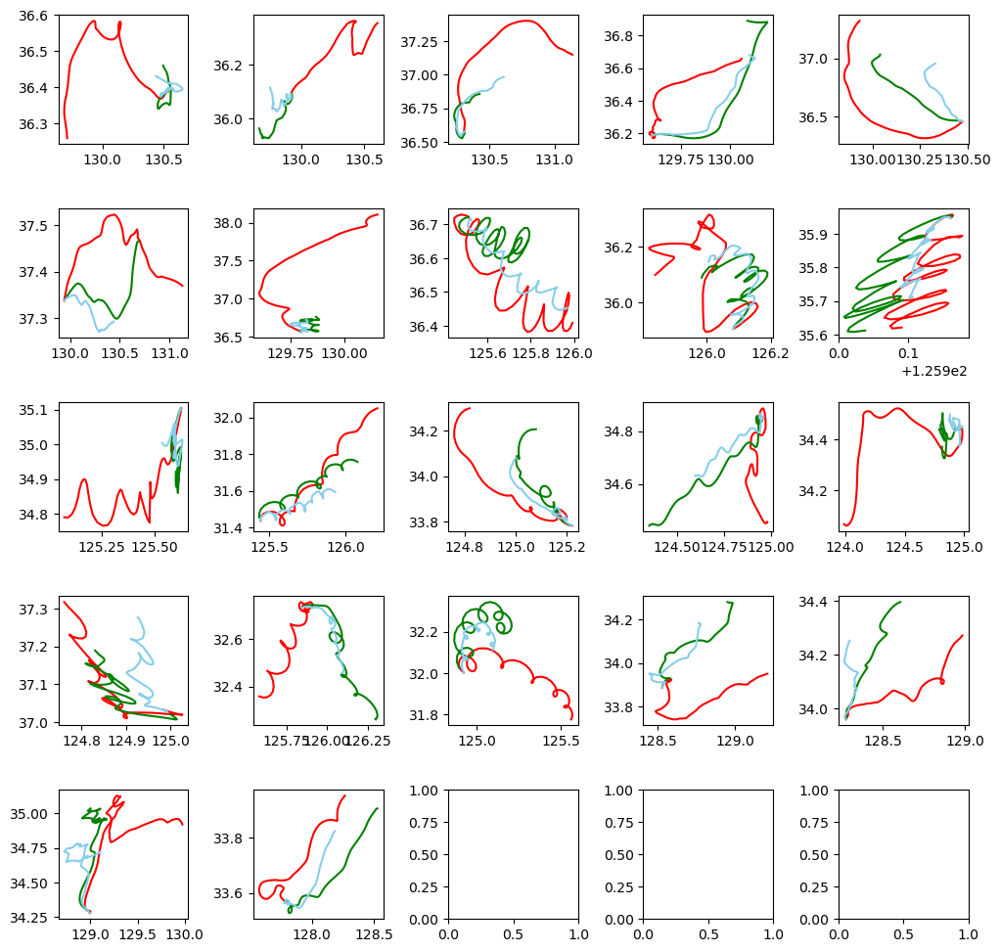

In [27]:
# 데이터 X 2
import lightgbm as lgb
seed = 42
tf.keras.utils.set_random_seed(seed)
random.seed(seed)
np.random.seed(seed)
tf.random.set_seed(seed)

f, axes = plt.subplots(5, 5)
# 격자 크기 설정
f.set_size_inches((12, 12))
# 격자 여백 설정
plt.subplots_adjust(wspace = 0.5, hspace = 0.5)
baseline_MAE_list = list() 
baseline_NCLS_list = list()
MAE_list = list()
NCLS_list = list()
test_case_list = list()

for i in range(len(dataset)):
    # train dataset
    train_X = pd.DataFrame()
    train_y = np.array([[]])
    train = dataset[0:i] + dataset[i+1:len(dataset)]
    
    AE_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
    train_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    train_y = train[0][['diff_lon', 'diff_lat']]
    # 첫 행은 훈련에서 제외
    AE_X = AE_X[1:]
    train_X = train_X[1:]
    train_y = train_y[1:].to_numpy()
    
    for j in range(1,len(train)):
        add = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = train[j][['diff_lon', 'diff_lat']]
        add = add[1:]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
        
    # 과거 데이터 훈련데이터에 추가
    for k in range(len(only_train_dataset)):
        add =  only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = only_train_dataset[k][['diff_lon', 'diff_lat']]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        add = add[1:]
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
    
    # Test dataset
    test = dataset[i]
    start_lon = dataset[i]['start_lon'][0]
    start_lat = dataset[i]['start_lat'][0]
    test_X = test[['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    test_X = test_X[1:]
    test_y = test[['diff_lon', 'diff_lat']]
    test_y = test_y[1:].to_numpy()
    
    
    latent_dim = 20
    AE_X = AE_X.to_numpy()
    autoencoder = Autoencoder(latent_dim)
    autoencoder.compile(optimizer='adam', loss='mse')
    autoencoder.fit(AE_X,AE_X,
                    epochs=150,
                    shuffle=True)
    encoded = autoencoder.encoder(AE_X).numpy()
    decoded = autoencoder.decoder(encoded).numpy()
    add_X = decoded[:,[0,1,2,3]]
    add_y = decoded[:,[4,5]]
    encoded_2 = autoencoder.encoder(decoded).numpy()
    decoded_2 = autoencoder.decoder(encoded_2).numpy()
    add_X_2 = decoded_2[:,[0,1,2,3]]
    add_y_2 = decoded_2[:,[4,5]]
    
    train_X = np.concatenate((train_X.to_numpy(),add_X), axis = 0)
    train_X = np.concatenate((train_X,add_X_2), axis = 0)
    
    train_y = np.concatenate((train_y,add_y), axis = 0)
    train_y = np.concatenate((train_y,add_y_2), axis = 0)
    
    
    # 행단위로 살펴보기
    test_case_df = dataset[i][['time', 'obs_x1_lon', 'obs_x1_lat', 'wind_y','wind_x','water_velocity_y','water_velocity_x','model_x2_lon', 'model_x2_lat']]
    test_case_df['rf_lon'] = start_lon
    test_case_df['rf_lat'] = start_lat
    test_case_df['ncls_model'] = 0
    test_case_df['ncls_rf'] = 0
    
    # lightgbm 모델 생성
    lightgb_lon = lgb.LGBMRegressor(objective='regression',num_leaves=5,
                              learning_rate=0.009, n_estimators=270,max_depth=4
                              )
    lightgb_lat = lgb.LGBMRegressor(objective='regression',num_leaves=5,
                              learning_rate=0.009, n_estimators=270,max_depth=4
                            )
    
    # lightgbm 모델 훈련
    lightgb_lon.fit(train_X, train_y[:,0])
    lightgb_lat.fit(train_X, train_y[:,1])
    
    # Predict
    y_pred_lon = lightgb_lon.predict(test_X)
    y_pred_lat = lightgb_lat.predict(test_X)
    y_pred_lon = y_pred_lon.reshape((len(y_pred_lon),1))
    y_pred_lat = y_pred_lat.reshape((len(y_pred_lat),1))
    y_pred = np.concatenate((y_pred_lon,y_pred_lat),axis = 1)
    # case 별로 이상행 탐색
    for k in range(1,len(test_case_df)-1):
        test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
        test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
        test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
        test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
    
    test_case_df['rf_diff_lon'] = test_case_df['rf_lon'].diff()
    test_case_df['rf_diff_lon'][0] = 0
    test_case_df['rf_diff_lat'] = test_case_df['rf_lat'].diff()  
    test_case_df['rf_diff_lat'][0] = 0
    test_case_df['model_diff_lon'] = test_case_df['model_x2_lon'].diff() 
    test_case_df['model_diff_lon'][0] = 0
    test_case_df['model_diff_lat'] = test_case_df['model_x2_lat'].diff()
    test_case_df['model_diff_lat'][0] = 0
    test_case_list.append(test_case_df)
    
    # Plot
    lon, lat, baseline_lon, baseline_lat, lon_pred, lat_pred = drift_trajection_show(i,y_pred)
    row = i//5
    col = i%5
    axes[row][col].plot(lon, lat,'r-' ,baseline_lon, baseline_lat, 'g-', lon_pred, lat_pred, 'skyblue')   
    
    # evaluation 
    y = np.concatenate((lon.reshape((lon.shape[0],1)), lat.reshape((lat.shape[0],1))),axis = 1)
    pred = np.concatenate((lon_pred.reshape((lon_pred.shape[0],1)), lat_pred.reshape((lat_pred.shape[0],1))),axis =1)
    baseline_pred = np.concatenate((baseline_lon.reshape((baseline_lon.shape[0],1)), baseline_lat.reshape((baseline_lat.shape[0],1))),axis =1)
    
    #mae
    MAE_list.append(drift_mae(y, pred))
    baseline_MAE_list.append(drift_mae(y, baseline_pred))
    
    #NCLS
    NCLS_list.append(NCLS_score(y, pred))
    baseline_NCLS_list.append(NCLS_score(y, baseline_pred))
    
    for i in range(len(MAE_list)):
        print('------------------------ Model ', i+1, '------------------------')
        print('baseline',str(i),' MAE : ',MAE_list[i])
        print('Model',str(i),' MAE : ', baseline_MAE_list[i])
        print('baseline',str(i),' NCLS : ',baseline_NCLS_list[i])
        print('Model',str(i),' NCLS : ', NCLS_list[i])

plt.show()

In [28]:
# lightgbm # 에포크 처리 
mae_sum = 0
baseline_mae_sum = 0
NCLS_sum = 0
baseline_NCLS_sum = 0

for i in range(len(dataset)):
    mae_sum += MAE_list[i]
    baseline_mae_sum += baseline_MAE_list[i]
    NCLS_sum += NCLS_list[i]
    baseline_NCLS_sum += baseline_NCLS_list[i]

# 라이브러리 Mae    
print ('Model Mae : ', mae_sum/len(dataset) )
print ('Baseline Mae : ', baseline_mae_sum/len(dataset) )
print ('Model NCLS : ', NCLS_sum/len(dataset) )
print ('Baseline NCLS : ', baseline_NCLS_sum/len(dataset) )

Model Mae :  0.18454559121519407
Baseline Mae :  0.18057603746811715
Model NCLS :  0.5270996937989652
Baseline NCLS :  0.5326670971119444


In [29]:
from tensorflow.keras.models import Model
from sklearn.metrics import mean_absolute_error
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.activations import relu
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import mean_absolute_error

class Autoencoder(Model):
    def __init__(self, latent_dim):
        super(Autoencoder, self).__init__()
        self.latent_dim = latent_dim   
        self.encoder = tf.keras.Sequential([
          Dense(units = latent_dim, input_dim = 6, activation='relu'),
        ])
        self.decoder = tf.keras.Sequential([
          Dense(6, activation='sigmoid')
        ])

    def call(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

Epoch 1/150
93/93 [==============================] - 0s 984us/step - loss: 8.5589
Epoch 2/150
93/93 [==============================] - 0s 960us/step - loss: 7.5268
Epoch 3/150
93/93 [==============================] - 0s 981us/step - loss: 7.2339
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1395
Epoch 5/150
93/93 [==============================] - 0s 987us/step - loss: 7.0965
Epoch 6/150
93/93 [==============================] - 0s 992us/step - loss: 7.0726
Epoch 7/150
93/93 [==============================] - 0s 970us/step - loss: 7.0574
Epoch 8/150
93/93 [==============================] - 0s 991us/step - loss: 7.0469
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0391
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0332
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0285
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0247
Epoch 13/150
93/93 [===

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
Epoch 1/150


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See

93/93 [==============================] - 0s 997us/step - loss: 8.1613
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.4991
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3300
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2664
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2354
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2175
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2060
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1978
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1919
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1873
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1837
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1808
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
Epoch 1/150


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in

93/93 [==============================] - 1s 986us/step - loss: 8.0238
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3271
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1727
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1169
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0843
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0648
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0524
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0439
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0379
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0333
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0298
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0270
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
Epoch 1/150


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in

93/93 [==============================] - 1s 959us/step - loss: 8.2921
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.5932
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3465
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2595
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2221
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2013
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1883
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1795
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1733
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1686
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1650
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1621
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
Epoch 1/150


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See

93/93 [==============================] - 0s 987us/step - loss: 7.9235
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3310
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1436
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0890
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0629
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0479
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0384
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0319
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0272
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0236
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0209
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0186
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in

93/93 [==============================] - 0s 1ms/step - loss: 8.1756
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3227
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1239
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0479
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0043
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9821
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9689
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9602
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9541
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9496
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9461
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9433
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCop

93/93 [==============================] - 0s 1ms/step - loss: 8.0441
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.4308
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2618
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2104
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1864
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1723
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1633
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1569
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1522
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1486
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1457
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1433
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/index

93/93 [==============================] - 0s 982us/step - loss: 8.0094
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2017
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0032
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9295
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8920
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8706
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8571
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8477
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8409
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8358
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8317
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8284
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in

93/93 [==============================] - 0s 1ms/step - loss: 7.6300
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2626
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1582
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1191
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0988
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0867
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0789
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0734
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0694
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0662
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0637
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0616
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in

93/93 [==============================] - 0s 953us/step - loss: 7.6761
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2778
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1917
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1566
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1374
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1253
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1171
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1111
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1064
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1027
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0997
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0972
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in

93/93 [==============================] - 0s 964us/step - loss: 8.0078
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.4941
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2851
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2123
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1820
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1658
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1560
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1494
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1446
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1410
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1383
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1359
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/index

93/93 [==============================] - 0s 991us/step - loss: 7.8527
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2458
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0787
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0247
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9992
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9846
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9754
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9690
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9644
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9608
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9580
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9557
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCop

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

Epoch 69/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1100
Epoch 70/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1100
Epoch 71/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1100
Epoch 72/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1100
Epoch 73/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1099
Epoch 74/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1099
Epoch 75/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1099
Epoch 76/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1099
Epoch 77/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1099
Epoch 78/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1099
Epoch 79/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1098
Epoch 80/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1098
Epoch 81/150
93/93 [========

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCop

93/93 [==============================] - 0s 1ms/step - loss: 7.7757
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3393
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2283
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1887
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1684
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1559
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1477
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1418
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1375
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1342
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1316
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1294
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/index

93/93 [==============================] - 0s 1ms/step - loss: 7.6121
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2475
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1642
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1301
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1115
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1001
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0927
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0876
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0839
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0810
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0788
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0769
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCop

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/index

93/93 [==============================] - 0s 982us/step - loss: 7.7490
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2261
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0948
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0469
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0224
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0073
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9972
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9898
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9844
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9801
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9767
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9738
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in

93/93 [==============================] - 0s 981us/step - loss: 7.6419
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2841
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1649
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1228
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1026
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0906
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0827
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0771
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0729
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0696
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0669
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0648
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

90/90 [==============================] - 0s 1ms/step - loss: 6.8479


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/index

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

93/93 [==============================] - 0s 1ms/step - loss: 7.0275
Epoch 148/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0275
Epoch 149/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0275
Epoch 150/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0275


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\278879271.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26179693790500147
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2788762180957596
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37541034393135675
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01426036580162482
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2766155184125872
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44300711448580465
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10515388926431342
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5116793315609477
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2046858800986144
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5452198725

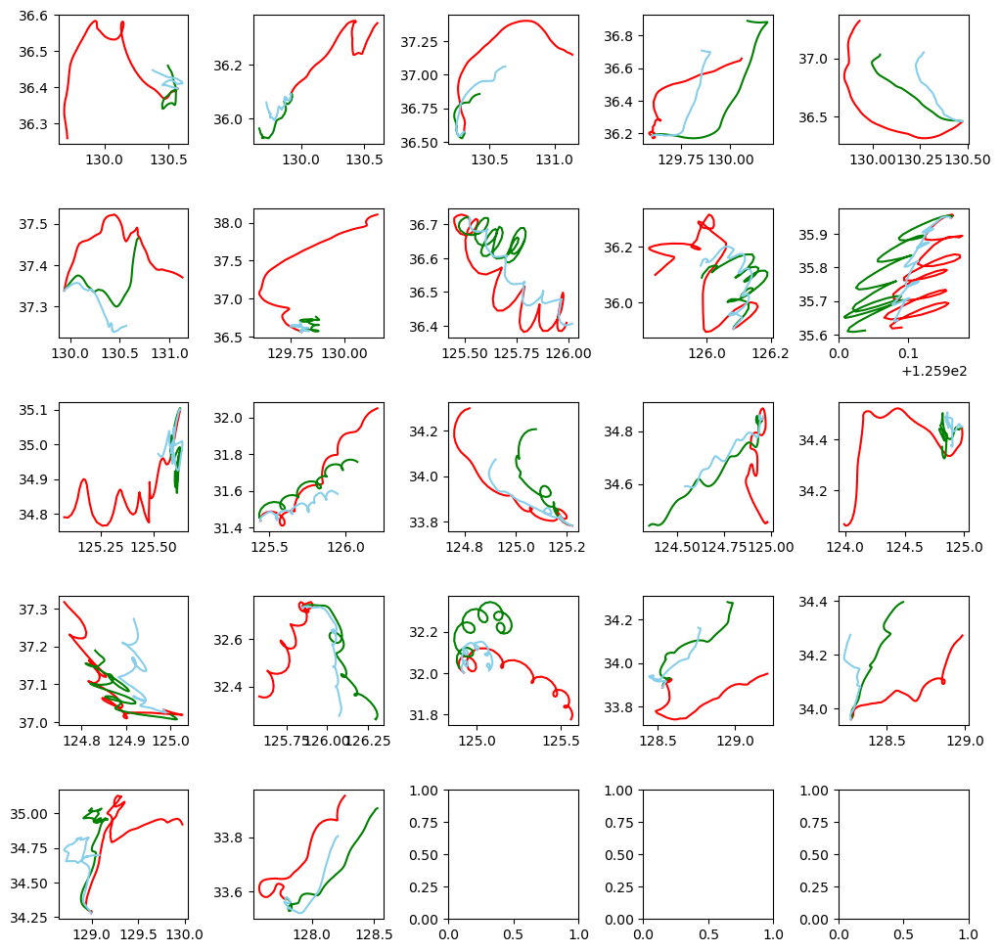

In [32]:
import lightgbm as lgb
seed = 42
tf.keras.utils.set_random_seed(seed)
random.seed(seed)
np.random.seed(seed)
tf.random.set_seed(seed)

f, axes = plt.subplots(5, 5)
# 격자 크기 설정
f.set_size_inches((12, 12))
# 격자 여백 설정
plt.subplots_adjust(wspace = 0.5, hspace = 0.5)
baseline_MAE_list = list() 
baseline_NCLS_list = list()
MAE_list = list()
NCLS_list = list()
test_case_list = list()

for i in range(len(dataset)):
    # train dataset
    train_X = pd.DataFrame()
    train_y = np.array([[]])
    train = dataset[0:i] + dataset[i+1:len(dataset)]
    
    AE_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
    train_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    train_y = train[0][['diff_lon', 'diff_lat']]
    # 첫 행은 훈련에서 제외
    AE_X = AE_X[1:]
    train_X = train_X[1:]
    train_y = train_y[1:].to_numpy()
    
    for j in range(1,len(train)):
        add = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = train[j][['diff_lon', 'diff_lat']]
        add = add[1:]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
        
    # 과거 데이터 훈련데이터에 추가
    for k in range(len(only_train_dataset)):
        add =  only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = only_train_dataset[k][['diff_lon', 'diff_lat']]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        add = add[1:]
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
    
    # Test dataset
    test = dataset[i]
    start_lon = dataset[i]['start_lon'][0]
    start_lat = dataset[i]['start_lat'][0]
    test_X = test[['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    test_X = test_X[1:]
    test_y = test[['diff_lon', 'diff_lat']]
    test_y = test_y[1:].to_numpy()
    
    
    latent_dim = 20
    AE_X = AE_X.to_numpy()
    autoencoder = Autoencoder(latent_dim)
    autoencoder.compile(optimizer='adam', loss='mse')
    autoencoder.fit(AE_X,AE_X,
                    epochs=150,
                    shuffle=True)
    encoded = autoencoder.encoder(AE_X).numpy()
    decoded = autoencoder.decoder(encoded).numpy()
    add_X = decoded[:,[0,1,2,3]]
    add_y = decoded[:,[4,5]]
    
    train_X = np.concatenate((train_X.to_numpy(),add_X), axis = 0)
    
    train_y = np.concatenate((train_y,add_y), axis = 0)
    
    
    # 행단위로 살펴보기
    test_case_df = dataset[i][['time', 'obs_x1_lon', 'obs_x1_lat', 'wind_y','wind_x','water_velocity_y','water_velocity_x','model_x2_lon', 'model_x2_lat']]
    test_case_df['rf_lon'] = start_lon
    test_case_df['rf_lat'] = start_lat
    test_case_df['ncls_model'] = 0
    test_case_df['ncls_rf'] = 0
    
    # lightgbm 모델 생성
    lightgb_lon = lgb.LGBMRegressor(objective='regression',num_leaves=5,
                              learning_rate=0.009, n_estimators=270,max_depth=4
                              )
    lightgb_lat = lgb.LGBMRegressor(objective='regression',num_leaves=5,
                              learning_rate=0.009, n_estimators=270,max_depth=4
                            )
    
    # lightgbm 모델 훈련
    lightgb_lon.fit(train_X, train_y[:,0])
    lightgb_lat.fit(train_X, train_y[:,1])
    
    # Predict
    y_pred_lon = lightgb_lon.predict(test_X)
    y_pred_lat = lightgb_lat.predict(test_X)
    y_pred_lon = y_pred_lon.reshape((len(y_pred_lon),1))
    y_pred_lat = y_pred_lat.reshape((len(y_pred_lat),1))
    y_pred = np.concatenate((y_pred_lon,y_pred_lat),axis = 1)
    # case 별로 이상행 탐색
    for k in range(1,len(test_case_df)-1):
        test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
        test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
        test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
        test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
    
    test_case_df['rf_diff_lon'] = test_case_df['rf_lon'].diff()
    test_case_df['rf_diff_lon'][0] = 0
    test_case_df['rf_diff_lat'] = test_case_df['rf_lat'].diff()  
    test_case_df['rf_diff_lat'][0] = 0
    test_case_df['model_diff_lon'] = test_case_df['model_x2_lon'].diff() 
    test_case_df['model_diff_lon'][0] = 0
    test_case_df['model_diff_lat'] = test_case_df['model_x2_lat'].diff()
    test_case_df['model_diff_lat'][0] = 0
    test_case_list.append(test_case_df)
    
    # Plot
    lon, lat, baseline_lon, baseline_lat, lon_pred, lat_pred = drift_trajection_show(i,y_pred)
    row = i//5
    col = i%5
    axes[row][col].plot(lon, lat,'r-' ,baseline_lon, baseline_lat, 'g-', lon_pred, lat_pred, 'skyblue')   
    
    # evaluation 
    y = np.concatenate((lon.reshape((lon.shape[0],1)), lat.reshape((lat.shape[0],1))),axis = 1)
    pred = np.concatenate((lon_pred.reshape((lon_pred.shape[0],1)), lat_pred.reshape((lat_pred.shape[0],1))),axis =1)
    baseline_pred = np.concatenate((baseline_lon.reshape((baseline_lon.shape[0],1)), baseline_lat.reshape((baseline_lat.shape[0],1))),axis =1)
    
    #mae
    MAE_list.append(drift_mae(y, pred))
    baseline_MAE_list.append(drift_mae(y, baseline_pred))
    
    #NCLS
    NCLS_list.append(NCLS_score(y, pred))
    baseline_NCLS_list.append(NCLS_score(y, baseline_pred))
    
    for i in range(len(MAE_list)):
        print('------------------------ Model ', i+1, '------------------------')
        print('baseline',str(i),' MAE : ',MAE_list[i])
        print('Model',str(i),' MAE : ', baseline_MAE_list[i])
        print('baseline',str(i),' NCLS : ',baseline_NCLS_list[i])
        print('Model',str(i),' NCLS : ', NCLS_list[i])

plt.show()

In [33]:
# lightgbm # 에포크 처리 ############################################################################ 최고 
mae_sum = 0
baseline_mae_sum = 0
NCLS_sum = 0
baseline_NCLS_sum = 0

for i in range(len(dataset)):
    mae_sum += MAE_list[i]
    baseline_mae_sum += baseline_MAE_list[i]
    NCLS_sum += NCLS_list[i]
    baseline_NCLS_sum += baseline_NCLS_list[i]

# 라이브러리 Mae    
print ('Model Mae : ', mae_sum/len(dataset) )
print ('Baseline Mae : ', baseline_mae_sum/len(dataset) )
print ('Model NCLS : ', NCLS_sum/len(dataset) )
print ('Baseline NCLS : ', baseline_NCLS_sum/len(dataset) )

Model Mae :  0.1745012769815875
Baseline Mae :  0.18057603746811715
Model NCLS :  0.5579038862220785
Baseline NCLS :  0.5326670971119444


Epoch 1/150
93/93 [==============================] - 0s 954us/step - loss: 7.8929
Epoch 2/150
93/93 [==============================] - 0s 995us/step - loss: 7.2325
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0948
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0586
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0408
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0304
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0237
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0190
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0156
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0129
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0108
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0091
Epoch 13/150
93/93 [=============

Epoch 102/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 103/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 104/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 105/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 106/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 107/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 108/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 109/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 110/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 111/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 112/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9883
Epoch 113/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9883
Epoch 114/150
93

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
Epoch 1/150


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

93/93 [==============================] - 0s 1ms/step - loss: 8.3250
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.4562
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2892
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2425
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2195
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2059
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1970
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1907
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1860
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1823
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1794
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1769
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
Epoch 1/150


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

93/93 [==============================] - 0s 1ms/step - loss: 7.7561
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1845
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1034
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0719
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0548
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0443
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0373
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0322
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0285
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0255
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0231
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0211
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
Epoch 1/150


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWith

93/93 [==============================] - 0s 1ms/step - loss: 8.4823
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.5325
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3083
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2272
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1953
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1796
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1704
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1645
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1603
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1573
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1548
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1529
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
Epoch 1/150
93/93 [==============================] - 0s 1ms/step - loss: 7.7515
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2341
Epoch 3/150
93/93 [======================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWith

93/93 [==============================] - 0s 1ms/step - loss: 7.8579
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1842
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0461
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0028
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9808
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9675
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9588
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9526
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9480
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9443
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9414
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9390
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWith

93/93 [==============================] - 0s 1ms/step - loss: 7.5295
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0372
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9200
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8780
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8570
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8447
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8368
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8312
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8272
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8240
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8215
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 6.8195
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

93/93 [==============================] - 0s 1ms/step - loss: 7.0381
Epoch 83/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0380
Epoch 84/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0380
Epoch 85/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0380
Epoch 86/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0380
Epoch 87/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0380
Epoch 88/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0382
Epoch 89/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0380
Epoch 90/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0380
Epoch 91/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0380
Epoch 92/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0380
Epoch 93/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0380
Epoch 94/150
93/93 [=====================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

93/93 [==============================] - 0s 1ms/step - loss: 7.6386
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2463
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1670
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1382
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1230
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1135
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1072
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1027
Epoch 9/150
93/93 [==============================] - 0s 2ms/step - loss: 7.0993
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0967
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0946
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0928
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWith

93/93 [==============================] - 0s 990us/step - loss: 8.0931
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3692
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2423
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1990
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1770
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1637
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1551
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1490
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1445
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1410
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1383
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1361
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWith

93/93 [==============================] - 1s 988us/step - loss: 7.5480
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1280
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0386
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0040
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9859
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9750
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9679
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9628
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9591
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9562
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9539
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9520
Epoch 13/150
93/93 [===========================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

93/93 [==============================] - 0s 1ms/step - loss: 7.7735
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2788
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2045
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1759
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1606
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1512
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1451
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1406
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1373
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1347
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1326
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1309
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

93/93 [==============================] - 0s 1ms/step - loss: 7.6234
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2252
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1487
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1207
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1066
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0983
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0930
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0892
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0864
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0842
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0825
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0810
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWith

93/93 [==============================] - 0s 1ms/step - loss: 7.7170
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2998
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2007
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1709
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1553
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1457
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1392
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1341
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1306
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1278
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1257
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1238
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

93/93 [==============================] - 0s 1ms/step - loss: 7.7533
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2440
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1543
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1226
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1058
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0956
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0890
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0842
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0807
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0780
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0759
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0741
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

93/93 [==============================] - 0s 1ms/step - loss: 7.8752
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1946
Epoch 3/150
93/93 [==============================] - 0s 2ms/step - loss: 7.0613
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0237
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0046
Epoch 6/150
93/93 [==============================] - 0s 2ms/step - loss: 6.9931
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9856
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9802
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9762
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9731
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9707
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9686
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

93/93 [==============================] - 0s 1ms/step - loss: 7.6036
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2255
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1478
Epoch 4/150
93/93 [==============================] - 0s 2ms/step - loss: 7.1152
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0979
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0872
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0802
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0752
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0715
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0685
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0661
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0640
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

90/90 [==============================] - 0s 1ms/step - loss: 7.5829
Epoch 2/150
90/90 [==============================] - 0s 1ms/step - loss: 7.0770
Epoch 3/150
90/90 [==============================] - 0s 1ms/step - loss: 6.9665
Epoch 4/150
90/90 [==============================] - 0s 2ms/step - loss: 6.9239
Epoch 5/150
90/90 [==============================] - 0s 1ms/step - loss: 6.9031
Epoch 6/150
90/90 [==============================] - 0s 2ms/step - loss: 6.8913
Epoch 7/150
90/90 [==============================] - 0s 2ms/step - loss: 6.8839
Epoch 8/150
90/90 [==============================] - 0s 1ms/step - loss: 6.8788
Epoch 9/150
90/90 [==============================] - 0s 1ms/step - loss: 6.8751
Epoch 10/150
90/90 [==============================] - 0s 1ms/step - loss: 6.8722
Epoch 11/150
90/90 [==============================] - 0s 1ms/step - loss: 6.8700
Epoch 12/150
90/90 [==============================] - 0s 1ms/step - loss: 6.8682
Epoch 13/150
90/90 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

93/93 [==============================] - 0s 1ms/step - loss: 7.5679
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2016
Epoch 3/150
93/93 [==============================] - 0s 2ms/step - loss: 7.1225
Epoch 4/150
93/93 [==============================] - 0s 2ms/step - loss: 7.0923
Epoch 5/150
93/93 [==============================] - 0s 2ms/step - loss: 7.0769
Epoch 6/150
93/93 [==============================] - 0s 2ms/step - loss: 7.0675
Epoch 7/150
93/93 [==============================] - 0s 2ms/step - loss: 7.0613
Epoch 8/150
93/93 [==============================] - 0s 2ms/step - loss: 7.0569
Epoch 9/150
93/93 [==============================] - 0s 2ms/step - loss: 7.0536
Epoch 10/150
93/93 [==============================] - 0s 2ms/step - loss: 7.0511
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0490
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0473
Epoch 13/150
93/93 [=============================

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1964092055.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26244998055628715
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2824570301282283
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3741135775034337
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.01603105219726708
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2849644175515995
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.42711654892442186
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.10029893077360016
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5414961124162787
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.2081249442458644
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.53821544152

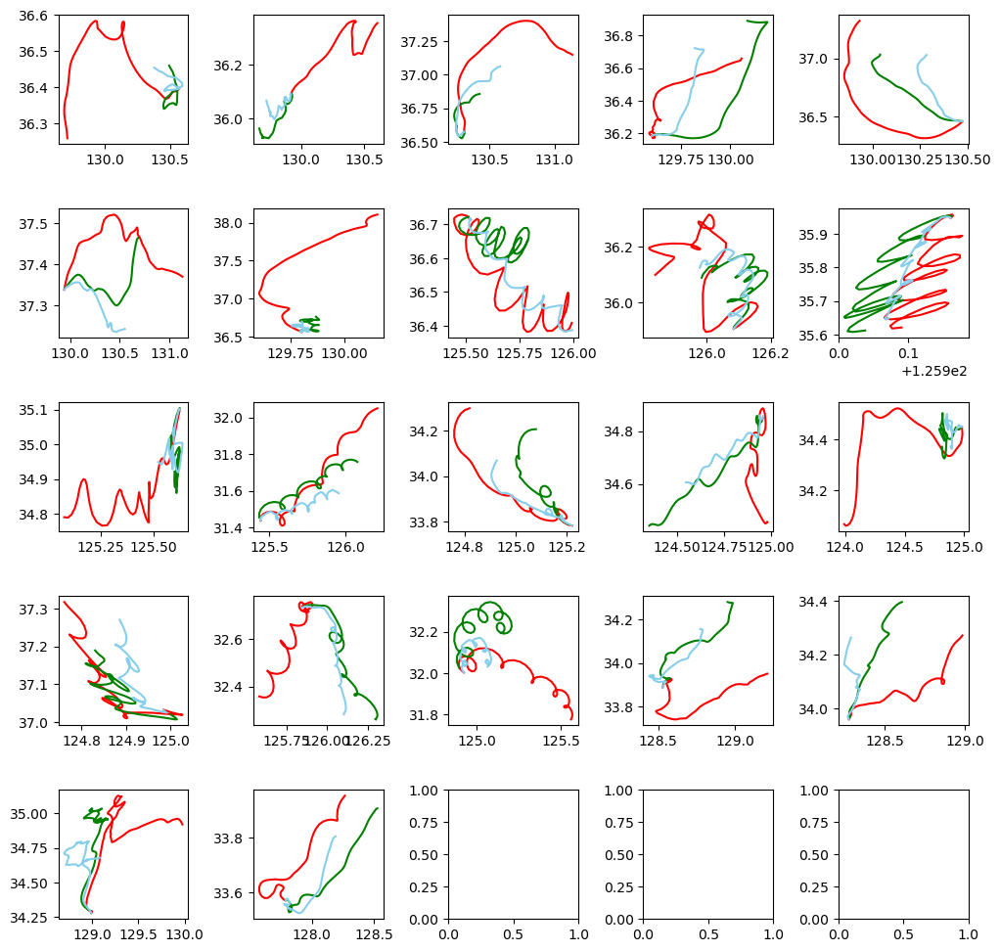

In [34]:
# 30
import lightgbm as lgb 
seed = 42
tf.keras.utils.set_random_seed(seed)
random.seed(seed)
np.random.seed(seed)
tf.random.set_seed(seed)

f, axes = plt.subplots(5, 5)
# 격자 크기 설정
f.set_size_inches((12, 12))
# 격자 여백 설정
plt.subplots_adjust(wspace = 0.5, hspace = 0.5)
baseline_MAE_list = list() 
baseline_NCLS_list = list()
MAE_list = list()
NCLS_list = list()
test_case_list = list()

for i in range(len(dataset)):
    # train dataset
    train_X = pd.DataFrame()
    train_y = np.array([[]])
    train = dataset[0:i] + dataset[i+1:len(dataset)]
    
    AE_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
    train_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    train_y = train[0][['diff_lon', 'diff_lat']]
    # 첫 행은 훈련에서 제외
    AE_X = AE_X[1:]
    train_X = train_X[1:]
    train_y = train_y[1:].to_numpy()
    
    for j in range(1,len(train)):
        add = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = train[j][['diff_lon', 'diff_lat']]
        add = add[1:]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
        
    # 과거 데이터 훈련데이터에 추가
    for k in range(len(only_train_dataset)):
        add =  only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = only_train_dataset[k][['diff_lon', 'diff_lat']]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        add = add[1:]
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
    
    # Test dataset
    test = dataset[i]
    start_lon = dataset[i]['start_lon'][0]
    start_lat = dataset[i]['start_lat'][0]
    test_X = test[['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    test_X = test_X[1:]
    test_y = test[['diff_lon', 'diff_lat']]
    test_y = test_y[1:].to_numpy()
    
    
    latent_dim = 30
    AE_X = AE_X.to_numpy()
    autoencoder = Autoencoder(latent_dim)
    autoencoder.compile(optimizer='adam', loss='mse')
    autoencoder.fit(AE_X,AE_X,
                    epochs=150,
                    shuffle=True)
    encoded = autoencoder.encoder(AE_X).numpy()
    decoded = autoencoder.decoder(encoded).numpy()
    add_X = decoded[:,[0,1,2,3]]
    add_y = decoded[:,[4,5]]
    
    train_X = np.concatenate((train_X.to_numpy(),add_X), axis = 0)
    
    train_y = np.concatenate((train_y,add_y), axis = 0)
    
    
    # 행단위로 살펴보기
    test_case_df = dataset[i][['time', 'obs_x1_lon', 'obs_x1_lat', 'wind_y','wind_x','water_velocity_y','water_velocity_x','model_x2_lon', 'model_x2_lat']]
    test_case_df['rf_lon'] = start_lon
    test_case_df['rf_lat'] = start_lat
    test_case_df['ncls_model'] = 0
    test_case_df['ncls_rf'] = 0
    
    # lightgbm 모델 생성
    lightgb_lon = lgb.LGBMRegressor(objective='regression',num_leaves=5,
                              learning_rate=0.009, n_estimators=270,max_depth=4
                              )
    lightgb_lat = lgb.LGBMRegressor(objective='regression',num_leaves=5,
                              learning_rate=0.009, n_estimators=270,max_depth=4
                            )
    
    # lightgbm 모델 훈련
    lightgb_lon.fit(train_X, train_y[:,0])
    lightgb_lat.fit(train_X, train_y[:,1])
    
    # Predict
    y_pred_lon = lightgb_lon.predict(test_X)
    y_pred_lat = lightgb_lat.predict(test_X)
    y_pred_lon = y_pred_lon.reshape((len(y_pred_lon),1))
    y_pred_lat = y_pred_lat.reshape((len(y_pred_lat),1))
    y_pred = np.concatenate((y_pred_lon,y_pred_lat),axis = 1)
    # case 별로 이상행 탐색
    for k in range(1,len(test_case_df)-1):
        test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
        test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
        test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
        test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
    
    test_case_df['rf_diff_lon'] = test_case_df['rf_lon'].diff()
    test_case_df['rf_diff_lon'][0] = 0
    test_case_df['rf_diff_lat'] = test_case_df['rf_lat'].diff()  
    test_case_df['rf_diff_lat'][0] = 0
    test_case_df['model_diff_lon'] = test_case_df['model_x2_lon'].diff() 
    test_case_df['model_diff_lon'][0] = 0
    test_case_df['model_diff_lat'] = test_case_df['model_x2_lat'].diff()
    test_case_df['model_diff_lat'][0] = 0
    test_case_list.append(test_case_df)
    
    # Plot
    lon, lat, baseline_lon, baseline_lat, lon_pred, lat_pred = drift_trajection_show(i,y_pred)
    row = i//5
    col = i%5
    axes[row][col].plot(lon, lat,'r-' ,baseline_lon, baseline_lat, 'g-', lon_pred, lat_pred, 'skyblue')   
    
    # evaluation 
    y = np.concatenate((lon.reshape((lon.shape[0],1)), lat.reshape((lat.shape[0],1))),axis = 1)
    pred = np.concatenate((lon_pred.reshape((lon_pred.shape[0],1)), lat_pred.reshape((lat_pred.shape[0],1))),axis =1)
    baseline_pred = np.concatenate((baseline_lon.reshape((baseline_lon.shape[0],1)), baseline_lat.reshape((baseline_lat.shape[0],1))),axis =1)
    
    #mae
    MAE_list.append(drift_mae(y, pred))
    baseline_MAE_list.append(drift_mae(y, baseline_pred))
    
    #NCLS
    NCLS_list.append(NCLS_score(y, pred))
    baseline_NCLS_list.append(NCLS_score(y, baseline_pred))
    
    for i in range(len(MAE_list)):
        print('------------------------ Model ', i+1, '------------------------')
        print('baseline',str(i),' MAE : ',MAE_list[i])
        print('Model',str(i),' MAE : ', baseline_MAE_list[i])
        print('baseline',str(i),' NCLS : ',baseline_NCLS_list[i])
        print('Model',str(i),' NCLS : ', NCLS_list[i])

plt.show()

In [35]:
# lightgbm # 에포크 처리
mae_sum = 0
baseline_mae_sum = 0
NCLS_sum = 0
baseline_NCLS_sum = 0

for i in range(len(dataset)):
    mae_sum += MAE_list[i]
    baseline_mae_sum += baseline_MAE_list[i]
    NCLS_sum += NCLS_list[i]
    baseline_NCLS_sum += baseline_NCLS_list[i]

# 라이브러리 Mae    
print ('Model Mae : ', mae_sum/len(dataset) )
print ('Baseline Mae : ', baseline_mae_sum/len(dataset) )
print ('Model NCLS : ', NCLS_sum/len(dataset) )
print ('Baseline NCLS : ', baseline_NCLS_sum/len(dataset) )

Model Mae :  0.17524708978930928
Baseline Mae :  0.18057603746811715
Model NCLS :  0.5586423416977108
Baseline NCLS :  0.5326670971119444


In [41]:
from tensorflow.keras.models import Model
from sklearn.metrics import mean_absolute_error
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.activations import relu
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import mean_absolute_error

class Autoencoder(Model):
    def __init__(self, latent_dim):
        super(Autoencoder, self).__init__()
        self.latent_dim = latent_dim   
        self.encoder = tf.keras.Sequential([
          Dense(units = latent_dim, input_dim = 6, activation='relu')
        ])
        self.decoder = tf.keras.Sequential([
          Dense(6, activation='sigmoid')
        ])

    def call(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

Epoch 1/150
93/93 [==============================] - 0s 1ms/step - loss: 6.4120
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 1.8881
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 0.3799
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0977
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0558
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0421
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0349
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0297
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0257
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0223
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0194
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0169
Epoch 13/150
93/93 [=================

93/93 [==============================] - 0s 2ms/step - loss: 3.3741e-05
Epoch 100/150
93/93 [==============================] - 0s 1ms/step - loss: 3.1933e-05
Epoch 101/150
93/93 [==============================] - 0s 2ms/step - loss: 3.4467e-05
Epoch 102/150
93/93 [==============================] - 0s 2ms/step - loss: 3.3577e-05
Epoch 103/150
93/93 [==============================] - 0s 2ms/step - loss: 3.3754e-05
Epoch 104/150
93/93 [==============================] - 0s 2ms/step - loss: 2.9239e-05
Epoch 105/150
93/93 [==============================] - 0s 2ms/step - loss: 2.7921e-05
Epoch 106/150
93/93 [==============================] - 0s 2ms/step - loss: 3.0623e-05
Epoch 107/150
93/93 [==============================] - 0s 2ms/step - loss: 4.3643e-05
Epoch 108/150
93/93 [==============================] - 0s 2ms/step - loss: 2.5650e-05
Epoch 109/150
93/93 [==============================] - 0s 2ms/step - loss: 2.7233e-05
Epoch 110/150
93/93 [==============================] - 0s 2ms/step -

C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:113: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2539355231297883
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.29325022807612
Epoch 1/150
93/93 [==============================] - 1s 1ms/step - loss: 7.7934
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 2.2004
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 0.3785
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0832
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0469
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0366
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0308
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0264
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0228
Epoch 10/150
93/93 [==============================] - 0s 2ms/step - loss: 0

93/93 [==============================] - 0s 2ms/step - loss: 5.4579e-05
Epoch 97/150
93/93 [==============================] - 0s 2ms/step - loss: 4.6316e-05
Epoch 98/150
93/93 [==============================] - 0s 1ms/step - loss: 6.0666e-05
Epoch 99/150
93/93 [==============================] - 0s 2ms/step - loss: 3.6321e-05
Epoch 100/150
93/93 [==============================] - 0s 2ms/step - loss: 3.6167e-05
Epoch 101/150
93/93 [==============================] - 0s 2ms/step - loss: 3.6191e-05
Epoch 102/150
93/93 [==============================] - 0s 2ms/step - loss: 3.4873e-05
Epoch 103/150
93/93 [==============================] - 0s 2ms/step - loss: 3.6544e-05
Epoch 104/150
93/93 [==============================] - 0s 2ms/step - loss: 3.4291e-05
Epoch 105/150
93/93 [==============================] - 0s 2ms/step - loss: 2.8796e-05
Epoch 106/150
93/93 [==============================] - 0s 2ms/step - loss: 2.9827e-05
Epoch 107/150
93/93 [==============================] - 0s 1ms/step - lo

C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2539355231297883
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.29325022807612
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35835987042078593
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03152426521596019
Epoch 1/150


C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



93/93 [==============================] - 0s 1ms/step - loss: 5.1056
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 0.8773
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 0.1367
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0551
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0395
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0325
Epoch 7/150
93/93 [==============================] - 0s 2ms/step - loss: 0.0277
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0234
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0199
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0170
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 0.0146
Epoch 12/150
93/93 [==============================] - 0s 2ms/step - loss: 0.0126
Epoch 13/150
93/93 [=============================

93/93 [==============================] - 0s 2ms/step - loss: 4.3831e-05
Epoch 100/150
93/93 [==============================] - 0s 1ms/step - loss: 4.0942e-05
Epoch 101/150
93/93 [==============================] - 0s 2ms/step - loss: 4.0131e-05
Epoch 102/150
93/93 [==============================] - 0s 2ms/step - loss: 4.0002e-05
Epoch 103/150
93/93 [==============================] - 0s 2ms/step - loss: 3.5861e-05
Epoch 104/150
93/93 [==============================] - 0s 2ms/step - loss: 3.5476e-05
Epoch 105/150
93/93 [==============================] - 0s 1ms/step - loss: 3.2475e-05
Epoch 106/150
93/93 [==============================] - 0s 2ms/step - loss: 3.4008e-05
Epoch 107/150
93/93 [==============================] - 0s 2ms/step - loss: 7.7777e-05
Epoch 108/150
93/93 [==============================] - 0s 2ms/step - loss: 2.7918e-05
Epoch 109/150
93/93 [==============================] - 0s 2ms/step - loss: 2.5902e-05
Epoch 110/150
93/93 [==============================] - 0s 2ms/step -

C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\915036699.py:113: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2539355231297883
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.29325022807612
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.35835987042078593
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03152426521596019
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.23118570962847312
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.5141268899514905


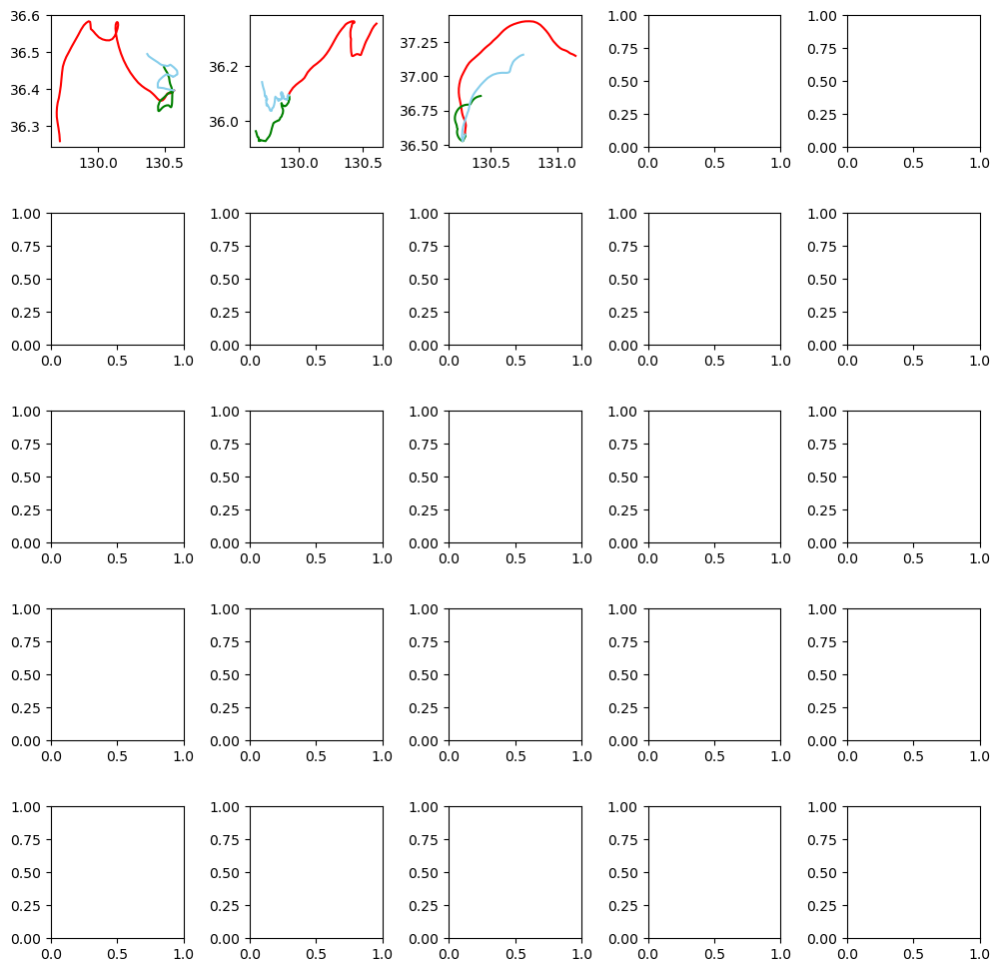

In [17]:
# 30
import lightgbm as lgb 
seed = 42
tf.keras.utils.set_random_seed(seed)
random.seed(seed)
np.random.seed(seed)
tf.random.set_seed(seed)

f, axes = plt.subplots(5, 5)
# 격자 크기 설정
f.set_size_inches((12, 12))
# 격자 여백 설정
plt.subplots_adjust(wspace = 0.5, hspace = 0.5)
baseline_MAE_list = list() 
baseline_NCLS_list = list()
MAE_list = list()
NCLS_list = list()
test_case_list = list()

for i in range(3):
    # train dataset
    train_X = pd.DataFrame()
    train_y = np.array([[]])
    train = dataset[0:i] + dataset[i+1:len(dataset)]
    
    AE_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
    train_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    train_y = train[0][['diff_lon', 'diff_lat']]
    # 첫 행은 훈련에서 제외
    AE_X = AE_X[1:]
    train_X = train_X[1:]
    train_y = train_y[1:].to_numpy()
    
    for j in range(1,len(train)):
        add = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = train[j][['diff_lon', 'diff_lat']]
        add = add[1:]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
        
    # 과거 데이터 훈련데이터에 추가
    for k in range(len(only_train_dataset)):
        add =  only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = only_train_dataset[k][['diff_lon', 'diff_lat']]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        add = add[1:]
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
    
    # Test dataset
    test = dataset[i]
    start_lon = dataset[i]['start_lon'][0]
    start_lat = dataset[i]['start_lat'][0]
    test_X = test[['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    test_X = test_X[1:]
    test_y = test[['diff_lon', 'diff_lat']]
    test_y = test_y[1:].to_numpy()
    
    
    latent_dim = 30
    AE_X = AE_X.to_numpy()
    autoencoder = Autoencoder(latent_dim)
    autoencoder.compile(optimizer='adam', loss='mse')
    autoencoder.fit(AE_X,AE_X,
                    epochs=150,
                    shuffle=True)
    encoded = autoencoder.encoder(AE_X).numpy()
    decoded = autoencoder.decoder(encoded).numpy()
    add_X = decoded[:,[0,1,2,3]]
    add_y = decoded[:,[4,5]]
    
    train_X = np.concatenate((train_X.to_numpy(),add_X), axis = 0)
    
    train_y = np.concatenate((train_y,add_y), axis = 0)
    
    
    # 행단위로 살펴보기
    test_case_df = dataset[i][['time', 'obs_x1_lon', 'obs_x1_lat', 'wind_y','wind_x','water_velocity_y','water_velocity_x','model_x2_lon', 'model_x2_lat']]
    test_case_df['rf_lon'] = start_lon
    test_case_df['rf_lat'] = start_lat
    test_case_df['ncls_model'] = 0
    test_case_df['ncls_rf'] = 0
    
    # lightgbm 모델 생성
    lightgb_lon = lgb.LGBMRegressor(objective='regression',num_leaves=6,
                              learning_rate=0.009, n_estimators=270,max_depth=5
                              )
    lightgb_lat = lgb.LGBMRegressor(objective='regression',num_leaves=6,
                              learning_rate=0.009, n_estimators=270,max_depth=5
                            )
    
    # lightgbm 모델 훈련
    lightgb_lon.fit(train_X, train_y[:,0])
    lightgb_lat.fit(train_X, train_y[:,1])
    
    # Predict
    y_pred_lon = lightgb_lon.predict(test_X)
    y_pred_lat = lightgb_lat.predict(test_X)
    y_pred_lon = y_pred_lon.reshape((len(y_pred_lon),1))
    y_pred_lat = y_pred_lat.reshape((len(y_pred_lat),1))
    y_pred = np.concatenate((y_pred_lon,y_pred_lat),axis = 1)
    # case 별로 이상행 탐색
    for k in range(1,len(test_case_df)-1):
        test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
        test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
        test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
        test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
    
    test_case_df['rf_diff_lon'] = test_case_df['rf_lon'].diff()
    test_case_df['rf_diff_lon'][0] = 0
    test_case_df['rf_diff_lat'] = test_case_df['rf_lat'].diff()  
    test_case_df['rf_diff_lat'][0] = 0
    test_case_df['model_diff_lon'] = test_case_df['model_x2_lon'].diff() 
    test_case_df['model_diff_lon'][0] = 0
    test_case_df['model_diff_lat'] = test_case_df['model_x2_lat'].diff()
    test_case_df['model_diff_lat'][0] = 0
    test_case_list.append(test_case_df)
    
    # Plot
    lon, lat, baseline_lon, baseline_lat, lon_pred, lat_pred = drift_trajection_show(i,y_pred)
    row = i//5
    col = i%5
    axes[row][col].plot(lon, lat,'r-' ,baseline_lon, baseline_lat, 'g-', lon_pred, lat_pred, 'skyblue')   
    
    # evaluation 
    y = np.concatenate((lon.reshape((lon.shape[0],1)), lat.reshape((lat.shape[0],1))),axis = 1)
    pred = np.concatenate((lon_pred.reshape((lon_pred.shape[0],1)), lat_pred.reshape((lat_pred.shape[0],1))),axis =1)
    baseline_pred = np.concatenate((baseline_lon.reshape((baseline_lon.shape[0],1)), baseline_lat.reshape((baseline_lat.shape[0],1))),axis =1)
    
    #mae
    MAE_list.append(drift_mae(y, pred))
    baseline_MAE_list.append(drift_mae(y, baseline_pred))
    
    #NCLS
    NCLS_list.append(NCLS_score(y, pred))
    baseline_NCLS_list.append(NCLS_score(y, baseline_pred))
    
    for i in range(len(MAE_list)):
        print('------------------------ Model ', i+1, '------------------------')
        print('baseline',str(i),' MAE : ',MAE_list[i])
        print('Model',str(i),' MAE : ', baseline_MAE_list[i])
        print('baseline',str(i),' NCLS : ',baseline_NCLS_list[i])
        print('Model',str(i),' NCLS : ', NCLS_list[i])

plt.show()

In [19]:
# lightgbm # 에포크 처리
mae_sum = 0
baseline_mae_sum = 0
NCLS_sum = 0
baseline_NCLS_sum = 0

# for i in range(len(dataset)):
#     mae_sum += MAE_list[i]
#     baseline_mae_sum += baseline_MAE_list[i]
#     NCLS_sum += NCLS_list[i]
#     baseline_NCLS_sum += baseline_NCLS_list[i]

# mae_sum += MAE_list[0]
# baseline_mae_sum += baseline_MAE_list[0]
# NCLS_sum += NCLS_list[0]
# baseline_NCLS_sum += baseline_NCLS_list[0]

# 라이브러리 Mae    
print ('Model Mae : ', MAE_list[0] )
print ('Baseline Mae : ', baseline_MAE_list[0] )
print ('Model NCLS : ', NCLS_list[0] )
print ('Baseline NCLS : ', baseline_NCLS_list[0])

Model Mae :  0.2539355231297883
Baseline Mae :  0.2775706597222227
Model NCLS :  0.29325022807612
Baseline NCLS :  0.2578343637823395


In [15]:
print(AE_X[0])
print(decoded[0])

[-0.8703071   0.1244297   1.3445895  -0.04352066  0.01786     0.01623   ]
[-0.86847365  0.12303888  1.3462074  -0.0434566   0.01531701  0.0155276 ]


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWith

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWith

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:118: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_diff_lon'] = test_case_df['rf_lon'].diff()
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:119: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_diff_lon'][0] = 0
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docume

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325


C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWith

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWith

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:113: SettingWith

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_4756\1525045855.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame



------------------------ Model  1 ------------------------
baseline 0  MAE :  0.26102656809781044
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.2856831681568305
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.3657507930902426
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.03941885112141874
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2678569354766292
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.45631394758089694
------------------------ Model  4 ------------------------
baseline 3  MAE :  0.09836312489514223
Model 3  MAE :  0.23924403521126655
baseline 3  NCLS :  0
Model 3  NCLS :  0.5547096943005325
------------------------ Model  5 ------------------------
baseline 4  MAE :  0.20702243935270384
Model 4  MAE :  0.1435844929577459
baseline 4  NCLS :  0.6956370589263559
Model 4  NCLS :  0.5380991087

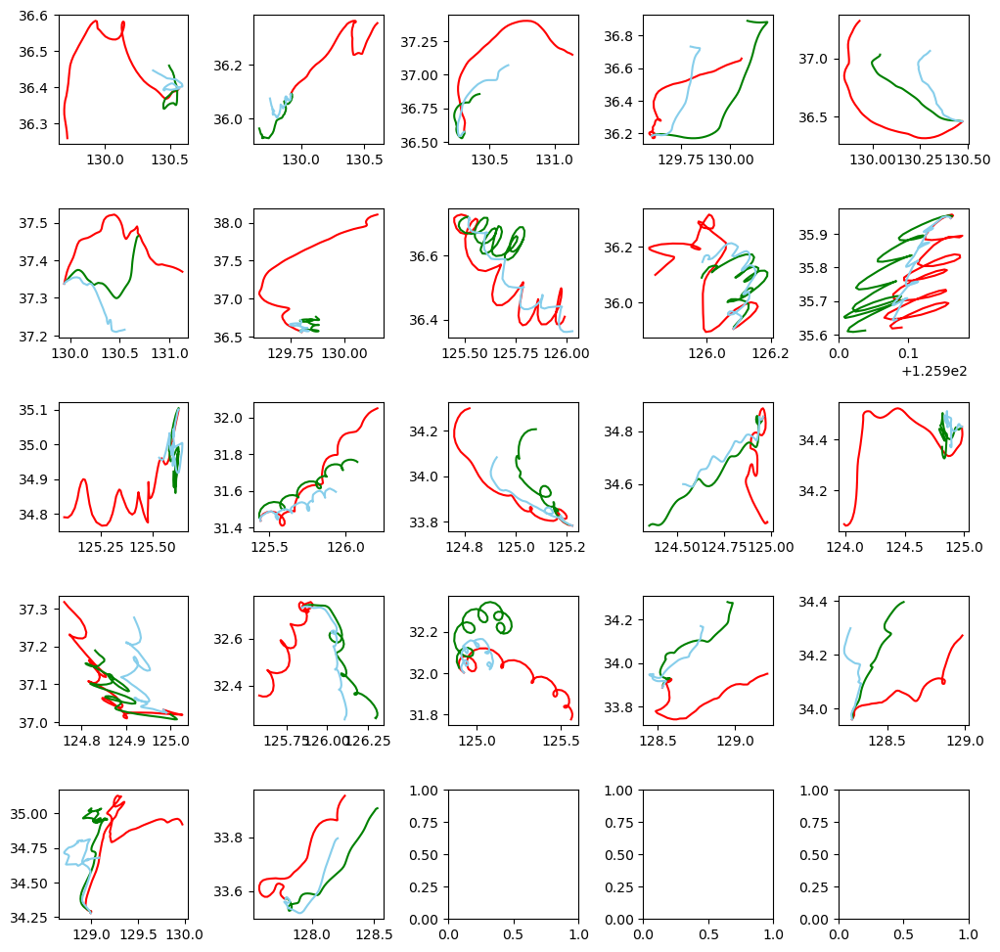

In [60]:
import lightgbm as lgb 
seed = 0
tf.keras.utils.set_random_seed(seed)
random.seed(seed)
np.random.seed(seed)
tf.random.set_seed(seed)

f, axes = plt.subplots(5, 5)
# 격자 크기 설정
f.set_size_inches((12, 12))
# 격자 여백 설정
plt.subplots_adjust(wspace = 0.5, hspace = 0.5)
baseline_MAE_list = list() 
baseline_NCLS_list = list()
MAE_list = list()
NCLS_list = list()
test_case_list = list()

for i in range(len(dataset)):
    # train dataset
    train_X = pd.DataFrame()
    train_y = np.array([[]])
    train = dataset[0:i] + dataset[i+1:len(dataset)]
    
    AE_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
    train_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    train_y = train[0][['diff_lon', 'diff_lat']]
    # 첫 행은 훈련에서 제외
    AE_X = AE_X[1:]
    train_X = train_X[1:]
    train_y = train_y[1:].to_numpy()
    
    for j in range(1,len(train)):
        add = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = train[j][['diff_lon', 'diff_lat']]
        add = add[1:]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
        
    # 과거 데이터 훈련데이터에 추가
    for k in range(len(only_train_dataset)):
        add =  only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = only_train_dataset[k][['diff_lon', 'diff_lat']]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        add = add[1:]
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
    
    # Test dataset
    test = dataset[i]
    start_lon = dataset[i]['start_lon'][0]
    start_lat = dataset[i]['start_lat'][0]
    test_X = test[['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    test_X = test_X[1:]
    test_y = test[['diff_lon', 'diff_lat']]
    test_y = test_y[1:].to_numpy()
    
    
    latent_dim = 30
    AE_X = AE_X.to_numpy()
    autoencoder = Autoencoder(latent_dim)
    autoencoder.compile(optimizer='adam', loss='mse')
    autoencoder.fit(AE_X,AE_X,
                    epochs=150,
                    verbose=0,
                    shuffle=True)
    encoded = autoencoder.encoder(AE_X).numpy()
    decoded = autoencoder.decoder(encoded).numpy()
    add_X = decoded[:,[0,1,2,3]]
    add_y = decoded[:,[4,5]]
    
    train_X = np.concatenate((train_X.to_numpy(),add_X), axis = 0)
    
    train_y = np.concatenate((train_y,add_y), axis = 0)
    
    
    # 행단위로 살펴보기
    test_case_df = dataset[i][['time', 'obs_x1_lon', 'obs_x1_lat', 'wind_y','wind_x','water_velocity_y','water_velocity_x','model_x2_lon', 'model_x2_lat']]
    test_case_df['rf_lon'] = start_lon
    test_case_df['rf_lat'] = start_lat
    test_case_df['ncls_model'] = 0
    test_case_df['ncls_rf'] = 0
    
    # lightgbm 모델 생성
    lightgb_lon = lgb.LGBMRegressor(objective='regression',num_leaves=6,
                              learning_rate=0.009, n_estimators=270,max_depth=5
                              )
    lightgb_lat = lgb.LGBMRegressor(objective='regression',num_leaves=6,
                              learning_rate=0.009, n_estimators=270,max_depth=5
                            )
    
    # lightgbm 모델 훈련
    lightgb_lon.fit(train_X, train_y[:,0])
    lightgb_lat.fit(train_X, train_y[:,1])
    
    # Predict
    y_pred_lon = lightgb_lon.predict(test_X)
    y_pred_lat = lightgb_lat.predict(test_X)
    y_pred_lon = y_pred_lon.reshape((len(y_pred_lon),1))
    y_pred_lat = y_pred_lat.reshape((len(y_pred_lat),1))
    y_pred = np.concatenate((y_pred_lon,y_pred_lat),axis = 1)
    # case 별로 이상행 탐색
    for k in range(1,len(test_case_df)-1):
        test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
        test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
        test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
        test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
    
    test_case_df['rf_diff_lon'] = test_case_df['rf_lon'].diff()
    test_case_df['rf_diff_lon'][0] = 0
    test_case_df['rf_diff_lat'] = test_case_df['rf_lat'].diff()  
    test_case_df['rf_diff_lat'][0] = 0
    test_case_df['model_diff_lon'] = test_case_df['model_x2_lon'].diff() 
    test_case_df['model_diff_lon'][0] = 0
    test_case_df['model_diff_lat'] = test_case_df['model_x2_lat'].diff()
    test_case_df['model_diff_lat'][0] = 0
    test_case_list.append(test_case_df)
    
    # Plot
    lon, lat, baseline_lon, baseline_lat, lon_pred, lat_pred = drift_trajection_show(i,y_pred)
    row = i//5
    col = i%5
    axes[row][col].plot(lon, lat,'r-' ,baseline_lon, baseline_lat, 'g-', lon_pred, lat_pred, 'skyblue')   
    
    # evaluation 
    y = np.concatenate((lon.reshape((lon.shape[0],1)), lat.reshape((lat.shape[0],1))),axis = 1)
    pred = np.concatenate((lon_pred.reshape((lon_pred.shape[0],1)), lat_pred.reshape((lat_pred.shape[0],1))),axis =1)
    baseline_pred = np.concatenate((baseline_lon.reshape((baseline_lon.shape[0],1)), baseline_lat.reshape((baseline_lat.shape[0],1))),axis =1)
    
    #mae
    MAE_list.append(drift_mae(y, pred))
    baseline_MAE_list.append(drift_mae(y, baseline_pred))
    
    #NCLS
    NCLS_list.append(NCLS_score(y, pred))
    baseline_NCLS_list.append(NCLS_score(y, baseline_pred))
    
    for i in range(len(MAE_list)):
        print('------------------------ Model ', i+1, '------------------------')
        print('baseline',str(i),' MAE : ',MAE_list[i])
        print('Model',str(i),' MAE : ', baseline_MAE_list[i])
        print('baseline',str(i),' NCLS : ',baseline_NCLS_list[i])
        print('Model',str(i),' NCLS : ', NCLS_list[i])

plt.show()

In [61]:
# lightgbm # 에포크 처리
mae_sum = 0
baseline_mae_sum = 0
NCLS_sum = 0
baseline_NCLS_sum = 0

for i in range(len(dataset)):
    mae_sum += MAE_list[i]
    baseline_mae_sum += baseline_MAE_list[i]
    NCLS_sum += NCLS_list[i]
    baseline_NCLS_sum += baseline_NCLS_list[i]

# 라이브러리 Mae    
print ('Model Mae : ', mae_sum/len(dataset) )
print ('Baseline Mae : ', baseline_mae_sum/len(dataset) )
print ('Model NCLS : ', NCLS_sum/len(dataset) )
print ('Baseline NCLS : ', baseline_NCLS_sum/len(dataset) )

Model Mae :  0.1749434536548172
Baseline Mae :  0.18057603746811715
Model NCLS :  0.5583046755540898
Baseline NCLS :  0.5326670971119444


C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3242836876.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3242836876.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3242836876.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instea

C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3242836876.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3242836876.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\3242836876.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the cave

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.24531645325154924
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.37407490325175563


KeyboardInterrupt: 

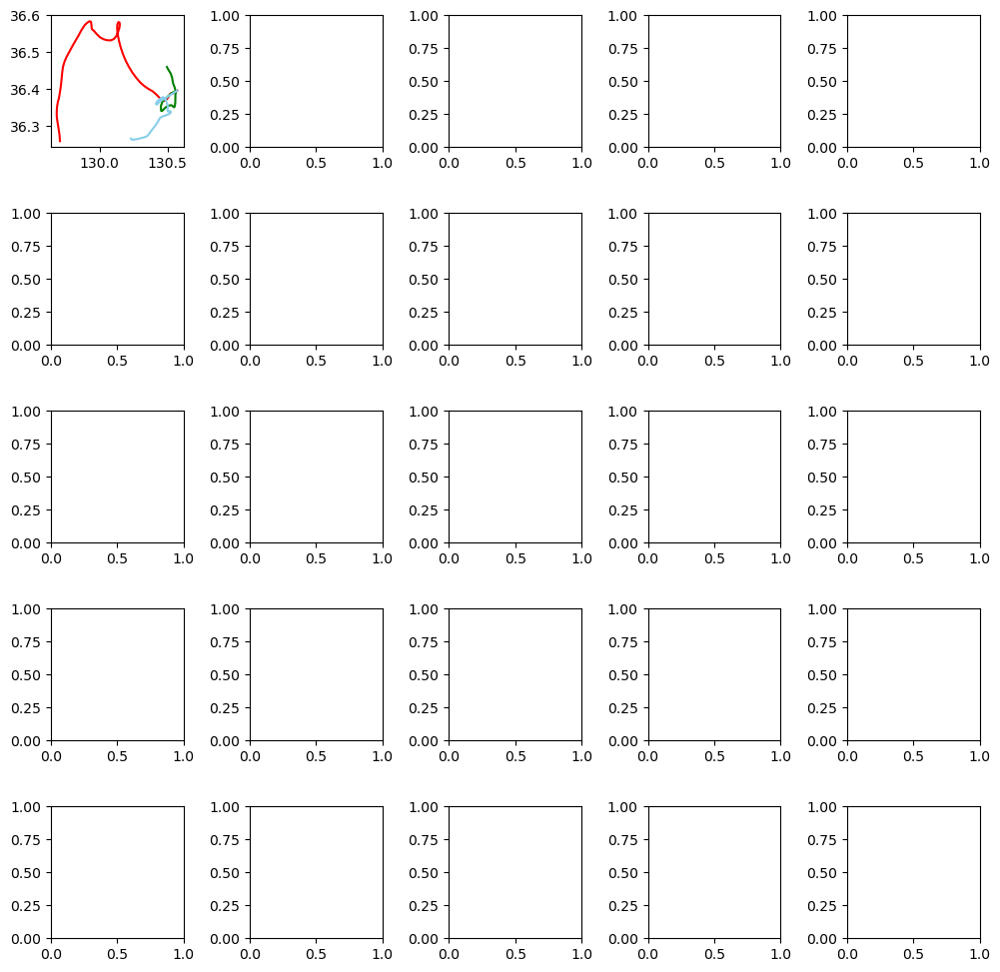

In [12]:
import lightgbm as lgb 
seed = 1
tf.keras.utils.set_random_seed(seed)
random.seed(seed)
np.random.seed(seed)
tf.random.set_seed(seed)

f, axes = plt.subplots(5, 5)
# 격자 크기 설정
f.set_size_inches((12, 12))
# 격자 여백 설정
plt.subplots_adjust(wspace = 0.5, hspace = 0.5)
baseline_MAE_list = list() 
baseline_NCLS_list = list()
MAE_list = list()
NCLS_list = list()
test_case_list = list()

for i in range(len(dataset)):
    # train dataset
    train_X = pd.DataFrame()
    train_y = np.array([[]])
    train = dataset[0:i] + dataset[i+1:len(dataset)]
    
    AE_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
    train_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    train_y = train[0][['diff_lon', 'diff_lat']]
    # 첫 행은 훈련에서 제외
    AE_X = AE_X[1:]
    train_X = train_X[1:]
    train_y = train_y[1:].to_numpy()
    
    for j in range(1,len(train)):
        add = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = train[j][['diff_lon', 'diff_lat']]
        add = add[1:]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
        
    # 과거 데이터 훈련데이터에 추가
    for k in range(len(only_train_dataset)):
        add =  only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = only_train_dataset[k][['diff_lon', 'diff_lat']]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        add = add[1:]
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
    
    # Test dataset
    test = dataset[i]
    start_lon = dataset[i]['start_lon'][0]
    start_lat = dataset[i]['start_lat'][0]
    test_X = test[['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    test_X = test_X[1:]
    test_y = test[['diff_lon', 'diff_lat']]
    test_y = test_y[1:].to_numpy()
    
    
    latent_dim = 30
    AE_X = AE_X.to_numpy()
    autoencoder = Autoencoder(latent_dim)
    autoencoder.compile(optimizer='adam', loss='mse')
    autoencoder.fit(AE_X,AE_X,
                    epochs=150,
                    verbose=0,
                    shuffle=True)
    encoded = autoencoder.encoder(AE_X).numpy()
    decoded = autoencoder.decoder(encoded).numpy()
    add_X = decoded[:,[0,1,2,3]]
    add_y = decoded[:,[4,5]]
    
    train_X = np.concatenate((train_X.to_numpy(),add_X), axis = 0)
    
    train_y = np.concatenate((train_y,add_y), axis = 0)
    
    
    # 행단위로 살펴보기
    test_case_df = dataset[i][['time', 'obs_x1_lon', 'obs_x1_lat', 'wind_y','wind_x','water_velocity_y','water_velocity_x','model_x2_lon', 'model_x2_lat']]
    test_case_df['rf_lon'] = start_lon
    test_case_df['rf_lat'] = start_lat
    test_case_df['ncls_model'] = 0
    test_case_df['ncls_rf'] = 0
    
    # lightgbm 모델 생성
    lightgb_lon = lgb.LGBMRegressor(objective='regression',num_leaves=6,
                              learning_rate=0.009, n_estimators=270,max_depth=5
                              )
    lightgb_lat = lgb.LGBMRegressor(objective='regression',num_leaves=6,
                              learning_rate=0.009, n_estimators=270,max_depth=5
                            )
    
    # lightgbm 모델 훈련
    lightgb_lon.fit(train_X, train_y[:,0])
    lightgb_lat.fit(train_X, train_y[:,1])
    
    # Predict
    y_pred_lon = lightgb_lon.predict(test_X)
    y_pred_lat = lightgb_lat.predict(test_X)
    y_pred_lon = y_pred_lon.reshape((len(y_pred_lon),1))
    y_pred_lat = y_pred_lat.reshape((len(y_pred_lat),1))
    y_pred = np.concatenate((y_pred_lon,y_pred_lat),axis = 1)
    # case 별로 이상행 탐색
    for k in range(1,len(test_case_df)-1):
        test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
        test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
        test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
        test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
    
    test_case_df['rf_diff_lon'] = test_case_df['rf_lon'].diff()
    test_case_df['rf_diff_lon'][0] = 0
    test_case_df['rf_diff_lat'] = test_case_df['rf_lat'].diff()  
    test_case_df['rf_diff_lat'][0] = 0
    test_case_df['model_diff_lon'] = test_case_df['model_x2_lon'].diff() 
    test_case_df['model_diff_lon'][0] = 0
    test_case_df['model_diff_lat'] = test_case_df['model_x2_lat'].diff()
    test_case_df['model_diff_lat'][0] = 0
    test_case_list.append(test_case_df)
    
    # Plot
    lon, lat, baseline_lon, baseline_lat, lon_pred, lat_pred = drift_trajection_show(i,y_pred)
    row = i//5
    col = i%5
    axes[row][col].plot(lon, lat,'r-' ,baseline_lon, baseline_lat, 'g-', lon_pred, lat_pred, 'skyblue')   
    
    # evaluation 
    y = np.concatenate((lon.reshape((lon.shape[0],1)), lat.reshape((lat.shape[0],1))),axis = 1)
    pred = np.concatenate((lon_pred.reshape((lon_pred.shape[0],1)), lat_pred.reshape((lat_pred.shape[0],1))),axis =1)
    baseline_pred = np.concatenate((baseline_lon.reshape((baseline_lon.shape[0],1)), baseline_lat.reshape((baseline_lat.shape[0],1))),axis =1)
    
    #mae
    MAE_list.append(drift_mae(y, pred))
    baseline_MAE_list.append(drift_mae(y, baseline_pred))
    
    #NCLS
    NCLS_list.append(NCLS_score(y, pred))
    baseline_NCLS_list.append(NCLS_score(y, baseline_pred))
    
    for i in range(len(MAE_list)):
        print('------------------------ Model ', i+1, '------------------------')
        print('baseline',str(i),' MAE : ',MAE_list[i])
        print('Model',str(i),' MAE : ', baseline_MAE_list[i])
        print('baseline',str(i),' NCLS : ',baseline_NCLS_list[i])
        print('Model',str(i),' NCLS : ', NCLS_list[i])

plt.show()

In [63]:
# lightgbm # 에포크 처리
mae_sum = 0
baseline_mae_sum = 0
NCLS_sum = 0
baseline_NCLS_sum = 0

for i in range(len(dataset)):
    mae_sum += MAE_list[i]
    baseline_mae_sum += baseline_MAE_list[i]
    NCLS_sum += NCLS_list[i]
    baseline_NCLS_sum += baseline_NCLS_list[i]

# 라이브러리 Mae    
print ('Model Mae : ', mae_sum/len(dataset) )
print ('Baseline Mae : ', baseline_mae_sum/len(dataset) )
print ('Model NCLS : ', NCLS_sum/len(dataset) )
print ('Baseline NCLS : ', baseline_NCLS_sum/len(dataset) )

Model Mae :  0.1742728702903483
Baseline Mae :  0.18057603746811715
Model NCLS :  0.557910464240276
Baseline NCLS :  0.5326670971119444


Epoch 1/150
93/93 [==============================] - 1s 1ms/step - loss: 7.8929
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2325
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0948
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0586
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0408
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0304
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0237
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0190
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0156
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0129
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0108
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0091
Epoch 13/150
93/93 [=================

93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 103/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 104/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 105/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 106/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 107/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 108/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 109/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 110/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 111/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9884
Epoch 112/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9883
Epoch 113/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9883
Epoch 114/150
93/93 [=========

C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\2067647769.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\2067647769.py:91: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\2067647769.py:92: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instea

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2588991635361649
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.29060504258913766
Epoch 1/150
93/93 [==============================] - 0s 1ms/step - loss: 8.3250
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.4562
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2892
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2425
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2195
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2059
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1970
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1907
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1860
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss

93/93 [==============================] - 0s 2ms/step - loss: 7.1514
Epoch 100/150
93/93 [==============================] - 0s 2ms/step - loss: 7.1514
Epoch 101/150
93/93 [==============================] - 0s 2ms/step - loss: 7.1514
Epoch 102/150
93/93 [==============================] - 0s 2ms/step - loss: 7.1514
Epoch 103/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1514
Epoch 104/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1514
Epoch 105/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1514
Epoch 106/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1514
Epoch 107/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1514
Epoch 108/150
93/93 [==============================] - 0s 2ms/step - loss: 7.1513
Epoch 109/150
93/93 [==============================] - 0s 2ms/step - loss: 7.1513
Epoch 110/150
93/93 [==============================] - 0s 2ms/step - loss: 7.1513
Epoch 111/150
93/93 [=========

C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\2067647769.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\2067647769.py:91: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\2067647769.py:92: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instea

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2588991635361649
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.29060504258913766
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37082802838886564
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.022837000892927284
Epoch 1/150


C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\2067647769.py:117: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\2067647769.py:118: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\2067647769.py:115: SettingW

93/93 [==============================] - 0s 1ms/step - loss: 7.7561
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1845
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.1034
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0719
Epoch 5/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0548
Epoch 6/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0443
Epoch 7/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0373
Epoch 8/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0322
Epoch 9/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0285
Epoch 10/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0255
Epoch 11/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0231
Epoch 12/150
93/93 [==============================] - 0s 1ms/step - loss: 7.0211
Epoch 13/150
93/93 [=============================

93/93 [==============================] - 0s 2ms/step - loss: 6.9982
Epoch 103/150
93/93 [==============================] - 0s 2ms/step - loss: 6.9982
Epoch 104/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9981
Epoch 105/150
93/93 [==============================] - 0s 2ms/step - loss: 6.9981
Epoch 106/150
93/93 [==============================] - 0s 2ms/step - loss: 6.9981
Epoch 107/150
93/93 [==============================] - 0s 2ms/step - loss: 6.9982
Epoch 108/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9981
Epoch 109/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9981
Epoch 110/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9981
Epoch 111/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9981
Epoch 112/150
93/93 [==============================] - 0s 2ms/step - loss: 6.9981
Epoch 113/150
93/93 [==============================] - 0s 1ms/step - loss: 6.9981
Epoch 114/150
93/93 [=========

C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\2067647769.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'] = start_lon
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\2067647769.py:91: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'] = start_lat
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\2067647769.py:92: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instea

C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\2067647769.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\2067647769.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
C:\Users\gusrl\AppData\Local\Temp\ipykernel_21468\2067647769.py:117: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

------------------------ Model  1 ------------------------
baseline 0  MAE :  0.2588991635361649
Model 0  MAE :  0.2775706597222227
baseline 0  NCLS :  0.2578343637823395
Model 0  NCLS :  0.29060504258913766
------------------------ Model  2 ------------------------
baseline 1  MAE :  0.37082802838886564
Model 1  MAE :  0.4105121875000021
baseline 1  NCLS :  0
Model 1  NCLS :  0.022837000892927284
------------------------ Model  3 ------------------------
baseline 2  MAE :  0.2703654473113023
Model 2  MAE :  0.35204785416666873
baseline 2  NCLS :  0.303683671695795
Model 2  NCLS :  0.44845319033871944
Epoch 1/150
93/93 [==============================] - 1s 1ms/step - loss: 8.4823
Epoch 2/150
93/93 [==============================] - 0s 1ms/step - loss: 7.5325
Epoch 3/150
93/93 [==============================] - 0s 1ms/step - loss: 7.3083
Epoch 4/150
93/93 [==============================] - 0s 1ms/step - loss: 7.2272
Epoch 5/150
 1/93 [..............................] - ETA: 0s - loss: 7.

KeyboardInterrupt: 

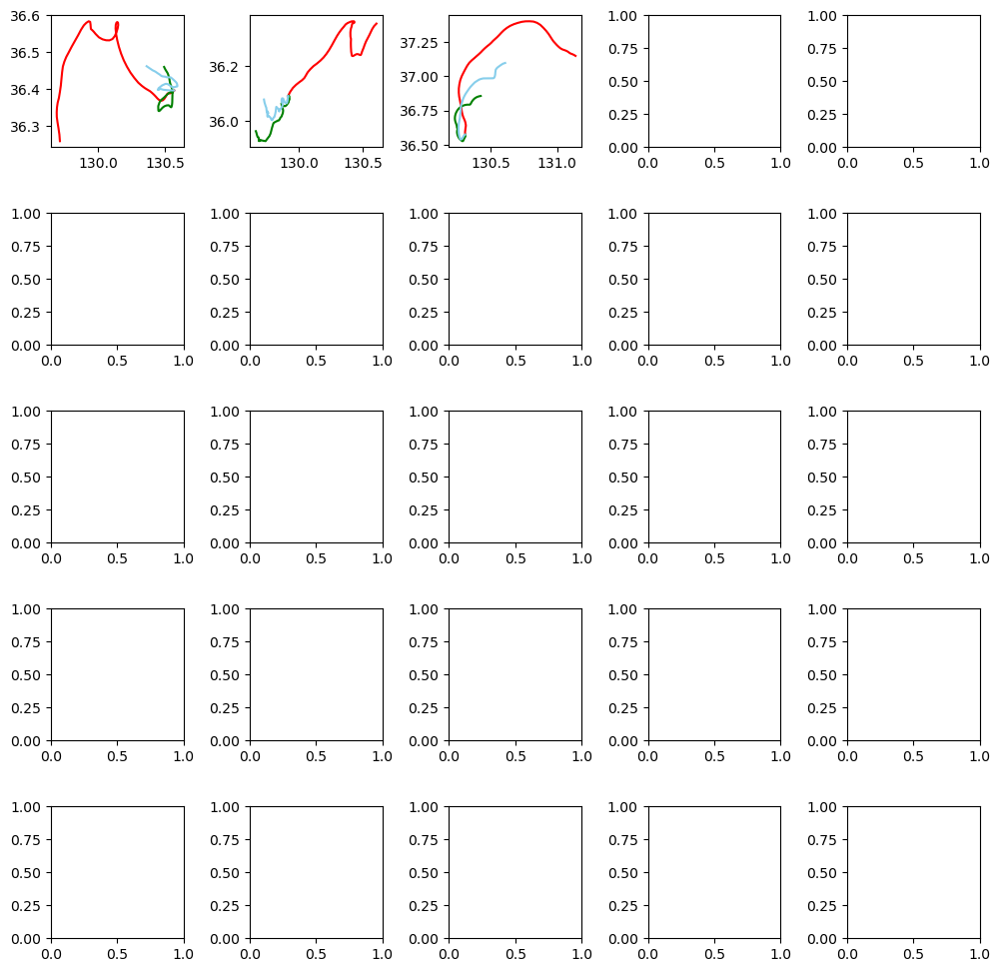

In [5]:
# 30
import lightgbm as lgb 
import random
seed = 42
tf.keras.utils.set_random_seed(seed)
random.seed(seed)
np.random.seed(seed)
tf.random.set_seed(seed)

f, axes = plt.subplots(5, 5)
# 격자 크기 설정
f.set_size_inches((12, 12))
# 격자 여백 설정
plt.subplots_adjust(wspace = 0.5, hspace = 0.5)
baseline_MAE_list = list() 
baseline_NCLS_list = list()
MAE_list = list()
NCLS_list = list()
test_case_list = list()

for i in range(len(dataset)):
    # train dataset
    train_X = pd.DataFrame()
    train_y = np.array([[]])
    train = dataset[0:i] + dataset[i+1:len(dataset)]
    
    AE_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
    train_X = train[0][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    train_y = train[0][['diff_lon', 'diff_lat']]
    # 첫 행은 훈련에서 제외
    AE_X = AE_X[1:]
    train_X = train_X[1:]
    train_y = train_y[1:].to_numpy()
    
    for j in range(1,len(train)):
        add = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = train[j][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = train[j][['diff_lon', 'diff_lat']]
        add = add[1:]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
        
    # 과거 데이터 훈련데이터에 추가
    for k in range(len(only_train_dataset)):
        add =  only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y','diff_lon', 'diff_lat']]
        trina_xi = only_train_dataset[k][['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']] 
        trina_yi = only_train_dataset[k][['diff_lon', 'diff_lat']]
        trina_xi = trina_xi[1:]
        trina_yi = trina_yi[1:].to_numpy()
        add = add[1:]
        
        AE_X = pd.concat([AE_X,add],ignore_index = True)
        train_X = pd.concat([train_X,trina_xi],ignore_index = True)
        train_y = np.concatenate((train_y,trina_yi), axis = 0)
    
    # Test dataset
    test = dataset[i]
    start_lon = dataset[i]['start_lon'][0]
    start_lat = dataset[i]['start_lat'][0]
    test_X = test[['wind_x', 'water_velocity_x', 'wind_y', 'water_velocity_y']]
    test_X = test_X[1:]
    test_y = test[['diff_lon', 'diff_lat']]
    test_y = test_y[1:].to_numpy()
    
    
    latent_dim = 30
    AE_X = AE_X.to_numpy()
    autoencoder = Autoencoder(latent_dim)
    autoencoder.compile(optimizer='adam', loss='mse')
    autoencoder.fit(AE_X,AE_X,
                    epochs=150,
                    shuffle=True
                   )
    
    encoded = autoencoder.encoder(AE_X).numpy()
    decoded = autoencoder.decoder(encoded).numpy()
    add_X = decoded[:,[0,1,2,3]]
    add_y = decoded[:,[4,5]]
    
    train_X = np.concatenate((train_X.to_numpy(),add_X), axis = 0)
    
    train_y = np.concatenate((train_y,add_y), axis = 0)
    
    
    # 행단위로 살펴보기
    test_case_df = dataset[i][['time', 'obs_x1_lon', 'obs_x1_lat', 'wind_y','wind_x','water_velocity_y','water_velocity_x','model_x2_lon', 'model_x2_lat']]
    test_case_df['rf_lon'] = start_lon
    test_case_df['rf_lat'] = start_lat
    test_case_df['ncls_model'] = 0
    test_case_df['ncls_rf'] = 0
    
    # lightgbm 모델 생성
    lightgb_lon = lgb.LGBMRegressor(objective='regression',num_leaves=6,
                              learning_rate=0.009, n_estimators=300,max_depth=5
                              )
    lightgb_lat = lgb.LGBMRegressor(objective='regression',num_leaves=6,
                              learning_rate=0.009, n_estimators=300,max_depth=5
                            )
    
    # lightgbm 모델 훈련
    lightgb_lon.fit(train_X, train_y[:,0])
    lightgb_lat.fit(train_X, train_y[:,1])
    
    # Predict
    y_pred_lon = lightgb_lon.predict(test_X)
    y_pred_lat = lightgb_lat.predict(test_X)
    y_pred_lon = y_pred_lon.reshape((len(y_pred_lon),1))
    y_pred_lat = y_pred_lat.reshape((len(y_pred_lat),1))
    y_pred = np.concatenate((y_pred_lon,y_pred_lat),axis = 1)
    # case 별로 이상행 탐색
    for k in range(1,len(test_case_df)-1):
        test_case_df['rf_lon'][k] = test_case_df['rf_lon'][k-1] + y_pred[k][0]
        test_case_df['rf_lat'][k] = test_case_df['rf_lat'][k-1] + y_pred[k][1]
        test_case_df['ncls_model'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['model_x2_lon','model_x2_lat']][:k+1].to_numpy())
        test_case_df['ncls_rf'][k] = NCLS_score(test_case_df[['obs_x1_lon','obs_x1_lat']][:k+1].to_numpy(), test_case_df[['rf_lon','rf_lat']][:k+1].to_numpy())
    
    test_case_df['rf_diff_lon'] = test_case_df['rf_lon'].diff()
    test_case_df['rf_diff_lon'][0] = 0
    test_case_df['rf_diff_lat'] = test_case_df['rf_lat'].diff()  
    test_case_df['rf_diff_lat'][0] = 0
    test_case_df['model_diff_lon'] = test_case_df['model_x2_lon'].diff() 
    test_case_df['model_diff_lon'][0] = 0
    test_case_df['model_diff_lat'] = test_case_df['model_x2_lat'].diff()
    test_case_df['model_diff_lat'][0] = 0
    test_case_list.append(test_case_df)
    
    # Plot
    lon, lat, baseline_lon, baseline_lat, lon_pred, lat_pred = drift_trajection_show(i,y_pred)
    row = i//5
    col = i%5
    axes[row][col].plot(lon, lat,'r-' ,baseline_lon, baseline_lat, 'g-', lon_pred, lat_pred, 'skyblue')   
    
    # evaluation 
    y = np.concatenate((lon.reshape((lon.shape[0],1)), lat.reshape((lat.shape[0],1))),axis = 1)
    pred = np.concatenate((lon_pred.reshape((lon_pred.shape[0],1)), lat_pred.reshape((lat_pred.shape[0],1))),axis =1)
    baseline_pred = np.concatenate((baseline_lon.reshape((baseline_lon.shape[0],1)), baseline_lat.reshape((baseline_lat.shape[0],1))),axis =1)
    
    #mae
    MAE_list.append(drift_mae(y, pred))
    baseline_MAE_list.append(drift_mae(y, baseline_pred))
    
    #NCLS
    NCLS_list.append(NCLS_score(y, pred))
    baseline_NCLS_list.append(NCLS_score(y, baseline_pred))
    
    for i in range(len(MAE_list)):
        print('------------------------ Model ', i+1, '------------------------')
        print('baseline',str(i),' MAE : ',MAE_list[i])
        print('Model',str(i),' MAE : ', baseline_MAE_list[i])
        print('baseline',str(i),' NCLS : ',baseline_NCLS_list[i])
        print('Model',str(i),' NCLS : ', NCLS_list[i])

plt.show()

In [8]:
print(AE_X[0])

[-5.2625866e+00 -2.0122075e-01 -4.7295530e+00  4.0052690e-03
 -1.5360000e-02 -5.4900000e-03]


In [7]:
print(decoded[0])

[1.0080528e-11 1.4209801e-04 7.8251701e-13 1.1251386e-02 1.0561272e-09
 2.0069381e-06]


In [ ]:
# lightgbm # 에포크 처리
mae_sum = 0
baseline_mae_sum = 0
NCLS_sum = 0
baseline_NCLS_sum = 0

for i in range(len(dataset)):
    mae_sum += MAE_list[i]
    baseline_mae_sum += baseline_MAE_list[i]
    NCLS_sum += NCLS_list[i]
    baseline_NCLS_sum += baseline_NCLS_list[i]

# 라이브러리 Mae    
print ('Model Mae : ', mae_sum/len(dataset) )
print ('Baseline Mae : ', baseline_mae_sum/len(dataset) )
print ('Model NCLS : ', NCLS_sum/len(dataset) )
print ('Baseline NCLS : ', baseline_NCLS_sum/len(dataset) )

In [53]:
pd.set_option('display.max_rows', None)
dataset[3][['wind_x','wind_y','water_velocity_x','water_velocity_y','diff_lon','diff_lat']]

,wind_x,wind_y,water_velocity_x,water_velocity_y,diff_lon,diff_lat
0,-3.577566,0.968968,0.337504,0.162600,0.00000,0.00000
1,-2.943117,1.027471,0.396950,0.106503,-0.00382,0.00220
2,-2.318464,0.824557,0.443865,0.049471,-0.00438,0.00414
3,-1.760264,0.605069,0.500898,-0.014646,-0.00376,0.00409
4,-1.259945,0.260068,0.567269,-0.087154,-0.00172,0.00417
5,-0.759643,-0.032336,0.562943,-0.095378,0.00150,0.00562
6,-0.889121,-0.137705,0.542913,-0.104780,0.00755,0.00374
7,-0.677803,-0.176970,0.521519,-0.126013,0.00963,-0.00121
8,-0.308836,-0.515790,0.506124,-0.153883,0.00842,-0.00838
9,0.014265,-0.839839,0.481760,-0.098021,0.00129,-0.00875
